## Setup

In [1]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import cv2
from tqdm import tqdm_notebook as tqdm
import glob
from collections import defaultdict

In [2]:
from joblib import Parallel, delayed

In [3]:
import os
import sys
sys.path.append("../")

In [4]:
def parallel_wrapper(it, f, *args, **kwargs):
    return Parallel(n_jobs=8, backend='multiprocessing')(delayed(f)(data, *args, **kwargs) for data in tqdm(it))

In [5]:
def _iterate_dcm_dir(in_dir="../data/raw/dicom-images-train/"):
    if not in_dir.endswith("/"):
        in_dir += "/"
    for fp in glob.glob(in_dir + '*/*/*.dcm'):
        yield fp
def id_from_filename(filename):
    return os.path.splitext(filename)[0]

In [6]:
import pydicom
def read_dcm(fp, v=0):
    """
    Read dcom file
    :param fp: str: dcom file path
    :return: np.ndarray: img as numpy array
    """
    ds = pydicom.read_file(fp)  # read dicom image
    img = ds.pixel_array  # get image array
    if v:
        print(ds)
    return img

In [7]:
from utils.mask_functions import rle2mask

In [8]:
def wrap_rle2mask(lst):
    shape = (1024, 1024)
    mask = np.zeros(shape, dtype=np.int)
    for rle in lst:
        mask[rle2mask(rle, *shape) > 0] = 1
    return mask

In [9]:
fields_of_interest = ["Modality",
"ConversionType",
"PatientName",
"PatientID",
"PatientSex",
"PatientAge",
"BodyPartExamined",
"ViewPosition",
"SeriesNumber",
"InstanceNumber",
"PatientOrientation",
"SamplesPerPixel",
"PhotometricInterpretation",
"Rows",
"Columns",
"PixelSpacing",
"BitsAllocated",
"BitsStored",
"HighBit",
"PixelRepresentation",
"LossyImageCompression",
"LossyImageCompressionMethod"]

In [10]:
import pickle as pkl

## Load data

In [11]:
dtypes = pkl.load(open("dtypes_data_with_metadata.pkl", "rb"))
df = pd.read_csv("data_with_metadata.csv", dtype=dtypes)
df["EncodedPixels"] = df.EncodedPixels.apply(eval)
df.loc[df["PatientAge"] > 100, "PatientAge"] = 60
df.head()

,ImageId,EncodedPixels,fp,empty,mean,new_mean,empty_area,mean_without_empty,Modality,ConversionType,...,Rows,Columns,PixelSpacing,BitsAllocated,BitsStored,HighBit,PixelRepresentation,LossyImageCompression,LossyImageCompressionMethod,mask_sum
0,1.2.276.0.7230010.3.1.4.8323329.1000.151787516...,[-1],../data/raw/dicom-images-train/1.2.276.0.72300...,True,169.965969,-4.336809e-18,0,169.965969,CR,WSD,...,1024,1024,0.168,8,8,7,0,01,ISO_10918_1,0
1,1.2.276.0.7230010.3.1.4.8323329.10000.15178752...,[-1],../data/raw/dicom-images-train/1.2.276.0.72300...,True,71.922405,-1.526557e-16,358243,109.245984,CR,WSD,...,1024,1024,0.139,8,8,7,0,01,ISO_10918_1,0
2,1.2.276.0.7230010.3.1.4.8323329.10001.15178752...,[-1],../data/raw/dicom-images-train/1.2.276.0.72300...,True,155.955172,1.821460e-17,1620,156.196488,CR,WSD,...,1024,1024,0.168,8,8,7,0,01,ISO_10918_1,0
3,1.2.276.0.7230010.3.1.4.8323329.10002.15178752...,[-1],../data/raw/dicom-images-train/1.2.276.0.72300...,True,125.845778,-4.163336e-17,7486,126.750677,CR,WSD,...,1024,1024,0.139,8,8,7,0,01,ISO_10918_1,0
4,1.2.276.0.7230010.3.1.4.8323329.10003.15178752...,[-1],../data/raw/dicom-images-train/1.2.276.0.72300...,True,125.757782,1.457168e-16,1231,125.905592,CR,WSD,...,1024,1024,0.168,8,8,7,0,01,ISO_10918_1,0


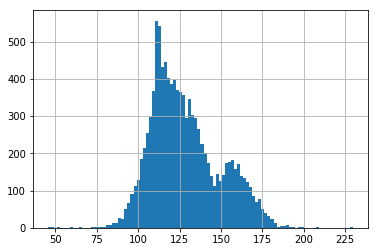

In [12]:
df.mean_without_empty.hist(bins=100)

In [13]:
for field in fields_of_interest:
    unique_values = df[field].unique()
    
    if len(unique_values) != len(df) and len(unique_values) > 1:
        print("F", field)
        if len(unique_values) > 10:
            print("\tToo big", len(unique_values))
        else:
            print("\tNormal")
        print("\t", unique_values[:10])
#     else:
#         print("Means nothing")


F PatientSex
	Normal
	 ['M' 'F']
F PatientAge
	Too big 91
	 [38 10 50 68 65 45 53 55 26 63]
F ViewPosition
	Normal
	 ['PA' 'AP']
F PixelSpacing
	Too big 11
	 ['0.168' '0.139' '0.171' '0.14300000000000002' '0.19431099999999998'
 '0.19430799999999998' '0.19431400000000001' '0.19433599999999998'
 '0.193754' '0.115']


In [16]:
df.ViewPosition.value_counts(normalize=True)

PA    0.608337
AP    0.391663
Name: ViewPosition, dtype: float64

## Data exploration

In [61]:
def plot(df, sample_size, masks=True, columns_to_plot=[]):
    for _, row in df.sample(min(sample_size, len(df))).iterrows():
        fp = row["fp"]
        img = read_dcm(fp)

        plt.subplot(121)
        print(" ".join(["{}:{}".format(k, row[k]) for k in columns_to_plot]))
        if not masks or row["empty"]:
#             plt.title(row["empty"])
            plt.imshow(img)
        else:
            mask = wrap_rle2mask(row["EncodedPixels"])
            plt.imshow(img)
            plt.subplot(122)
            plt.imshow(mask)

        plt.show()

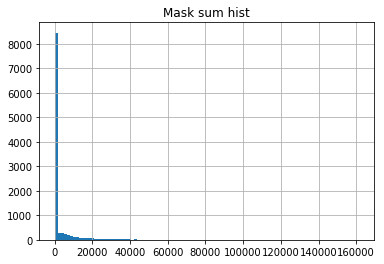

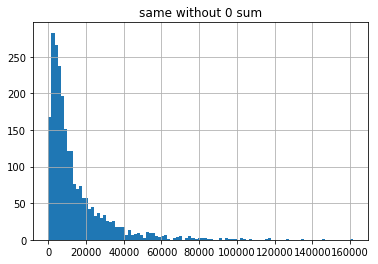

In [15]:
(df.mask_sum).hist(bins=100); plt.title("Mask sum hist"); plt.show()
df.mask_sum[df.mask_sum > 0].hist(bins=100); plt.title("same without 0 sum"); plt.show()

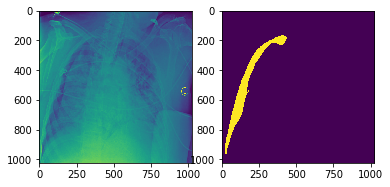

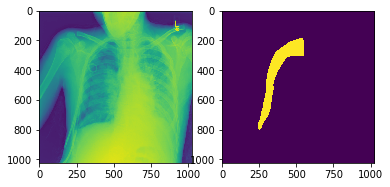

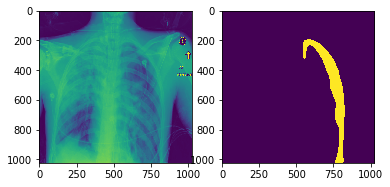

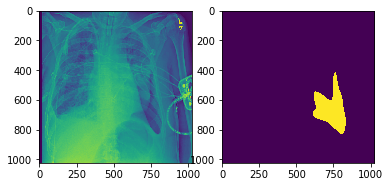

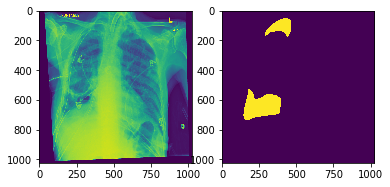

In [16]:
filter_mask = df.mask_sum > 40000
filter_mask &= df.mask_sum < 60000
plot(df[filter_mask], 5)

### Age

In [17]:
df.PatientAge.describe()

count    10675.000000
mean        47.036159
std         16.722593
min          1.000000
25%         35.000000
50%         49.000000
75%         60.000000
max         94.000000
Name: PatientAge, dtype: float64

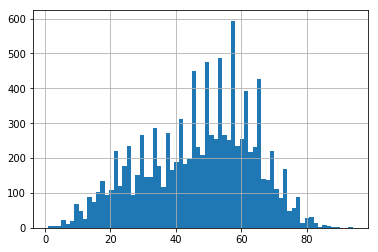

In [18]:
df.PatientAge.hist(bins=70)

0.168 3213 AxesSubplot(0.125,0.125;0.775x0.755)


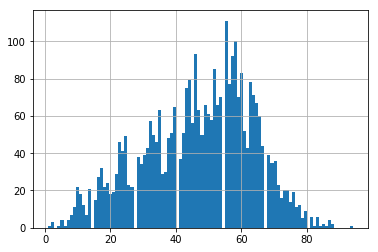

0.139 1966 AxesSubplot(0.125,0.125;0.775x0.755)


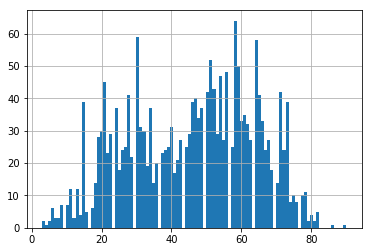

0.171 785 AxesSubplot(0.125,0.125;0.775x0.755)


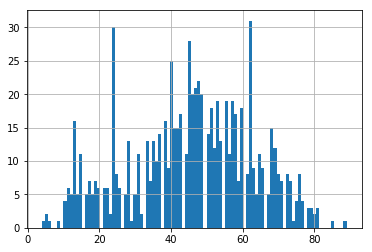

0.14300000000000002 3966 AxesSubplot(0.125,0.125;0.775x0.755)


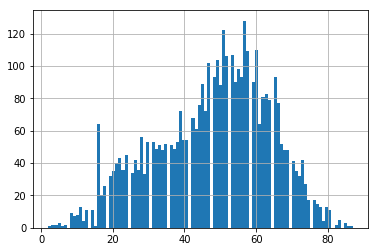

0.19431099999999998 715 AxesSubplot(0.125,0.125;0.775x0.755)


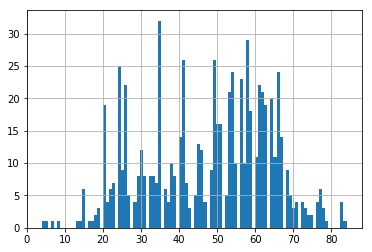

0.19430799999999998 10 AxesSubplot(0.125,0.125;0.775x0.755)


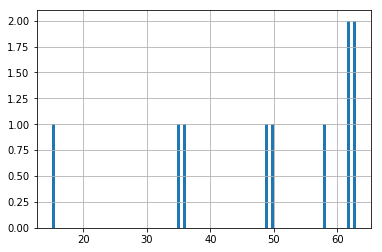

0.19431400000000001 14 AxesSubplot(0.125,0.125;0.775x0.755)


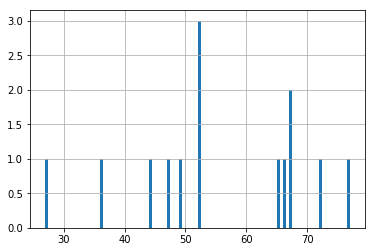

0.19433599999999998 1 AxesSubplot(0.125,0.125;0.775x0.755)


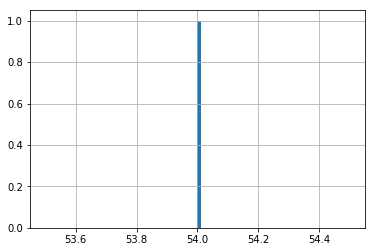

0.193754 1 AxesSubplot(0.125,0.125;0.775x0.755)


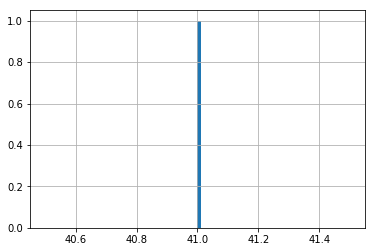

0.115 2 AxesSubplot(0.125,0.125;0.775x0.755)


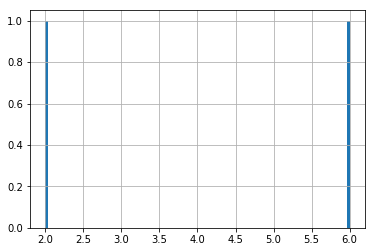

0.19378399999999998 2 AxesSubplot(0.125,0.125;0.775x0.755)


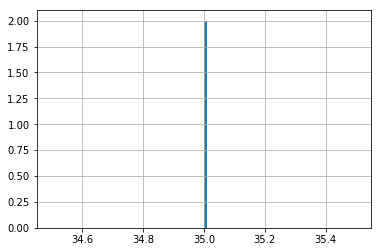

In [170]:
for ps in df.PixelSpacing.unique():
    print(ps, (df.PixelSpacing == ps).sum(), df[df.PixelSpacing == ps].PatientAge.hist(bins=100))
    plt.show()


### Patience Sex

In [19]:
df.PatientSex.value_counts(normalize=True)

M    0.55082
F    0.44918
Name: PatientSex, dtype: float64

In [20]:
df.groupby("PatientSex")["empty"].apply(np.mean)

PatientSex
F    0.780396
M    0.774490
Name: empty, dtype: float64

### Patient Pixel Spacing

Length 1966 PixelSpacing 0.139


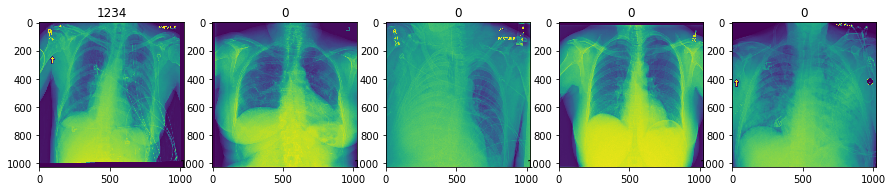

Length 3966 PixelSpacing 0.14300000000000002


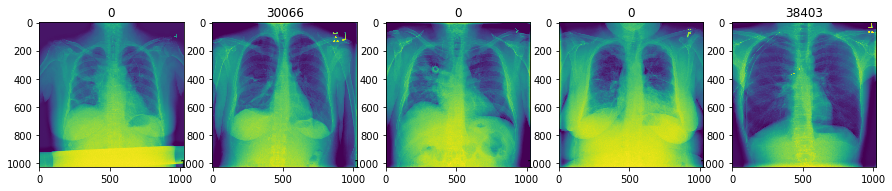

Length 3213 PixelSpacing 0.168


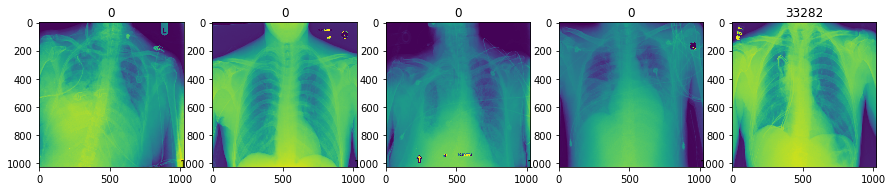

Length 785 PixelSpacing 0.171


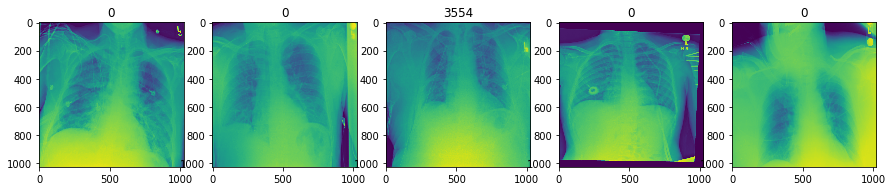

Length 715 PixelSpacing 0.19431099999999998


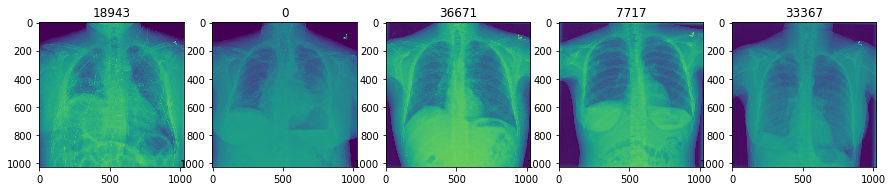

In [21]:
plots_per_group = 5
plot_height = 3
for PixelSpacing, index_list in df.reset_index().groupby("PixelSpacing")["index"].apply(list).items():
    # There around three groups which have small amount of images
    # and is not representable
    if len(index_list) < 15:
        continue

    print("Length", len(index_list), "PixelSpacing", PixelSpacing)
    plt.figure(figsize=(plot_height*plots_per_group, plot_height))
    for i in range(plots_per_group):
        random_index = np.random.choice(index_list)
        row = df.iloc[random_index]
        img = read_dcm(row["fp"])

        plt.subplot(1, plots_per_group, i+1)
        plt.title(row["mask_sum"])
        plt.imshow(img)
    plt.show()


### Samples from data with PixelSpacing given

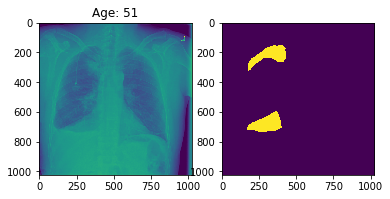

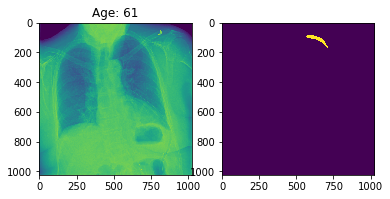

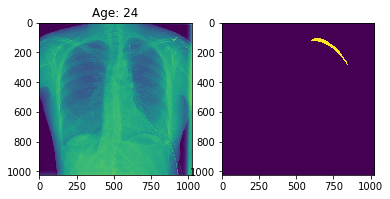

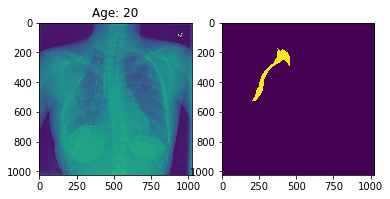

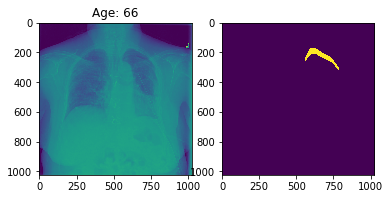

In [22]:
pixel_spacing_value = '0.19431099999999998'
sample_size = 5
filter_mask = np.ones(len(df), dtype=np.bool)
# filter by pixelspacing value
filter_mask &= (df.PixelSpacing == pixel_spacing_value)
filter_mask &= ~df['empty']
for _, row in df[filter_mask].sample(sample_size).iterrows():
    fp = row["fp"]
    mask_raw = row["EncodedPixels"]
    img = read_dcm(fp)

    plt.subplot(121)
    plt.title("Age: {row[PatientAge]}".format(row=row))
    plt.imshow(img)
    
    if mask_raw[0] != '-1':
        mask = wrap_rle2mask(mask_raw)
        plt.subplot(122)
        plt.imshow(mask)
    plt.show()


### Age distribution based on `PixelSpacing`

0.139


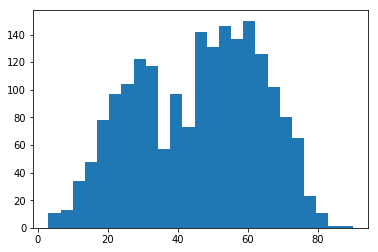

0.14300000000000002


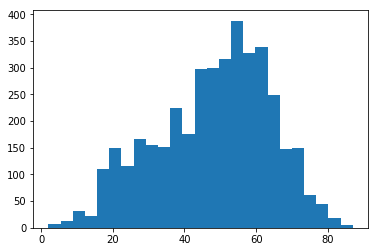

0.168


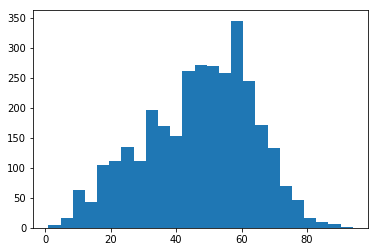

0.171


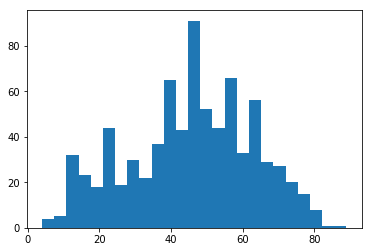

0.19431099999999998


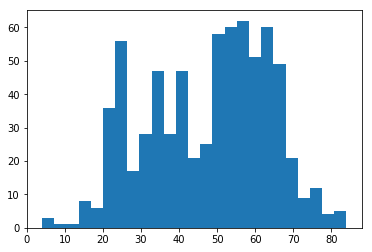

In [23]:
for _, row in df.groupby("PixelSpacing")["PatientAge"].apply(list).reset_index().iterrows():
    lst = row["PatientAge"]
    if len(lst) < 20:
        continue
    print(row["PixelSpacing"])
    plt.hist(lst, bins=25), plt.show()


### Image Means without `0` pixels distribution based on `PixelSpacing`

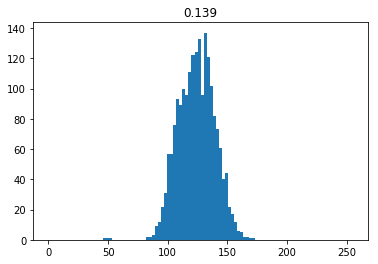

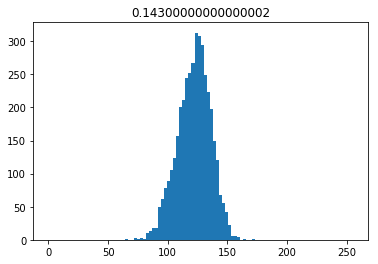

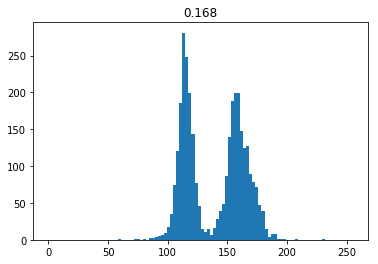

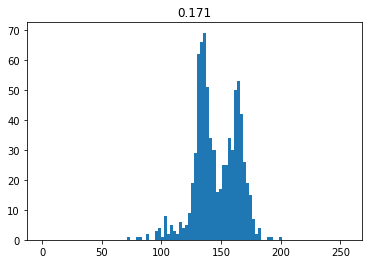

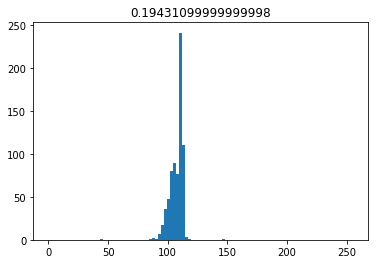

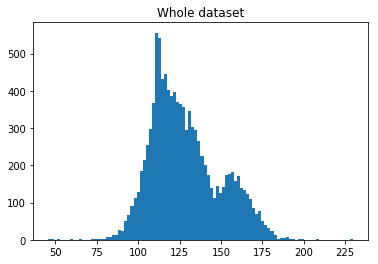

In [24]:
bins = 100
sample = df.groupby("PixelSpacing")["mean_without_empty"].apply(list).reset_index()
sample = sample[sample["mean_without_empty"].apply(len) > 19]
for _, row in sample.iterrows():
    lst = row["mean_without_empty"]
    plt.title(row["PixelSpacing"])
    plt.hist(lst, bins=bins, range=(0, 255))
    plt.show()
plt.title("Whole dataset")
plt.hist(df["mean_without_empty"], bins=bins), plt.show();

### Sex distribution based on `PixelSpacing`

In [25]:
sample = df.groupby("PixelSpacing")["PatientSex"].apply(list)
sample = sample[sample.apply(len) > 16]
sample.apply(lambda x: pd.value_counts(x, normalize=True))

,M,F
PixelSpacing,,
0.139,0.600712,0.399288
0.14300000000000002,0.523197,0.476803
0.168,0.570184,0.429816
0.171,0.563057,0.436943
0.19431099999999998,0.474126,0.525874


### `Y` distribution based on `PixelSpacing`

In [26]:
sample = df.groupby("PixelSpacing")["empty"].apply(list)
sample = sample[sample.apply(len) > 19]
sample = pd.DataFrame(dict(negative_fraction=sample.apply(np.mean),
                           positive_sum=sample.apply(lambda x: (1-np.mean(x))*len(x))))
sample

,negative_fraction,positive_sum
PixelSpacing,,
0.139,0.735504,520.0
0.14300000000000002,0.749117,995.0
0.168,0.853719,470.0
0.171,0.848408,119.0
0.19431099999999998,0.632168,263.0


## Play with samples from different PixelSpaces

Length 1966 PixelSpacing 0.139


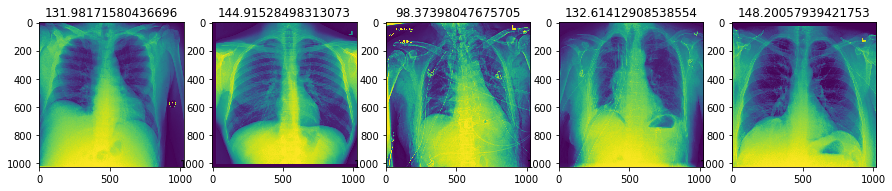

Length 3966 PixelSpacing 0.14300000000000002


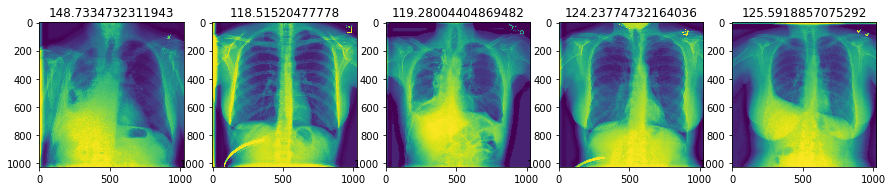

Length 3213 PixelSpacing 0.168


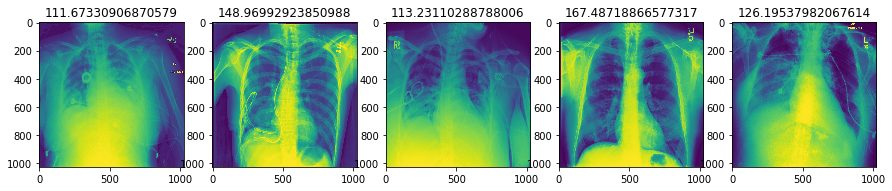

Length 785 PixelSpacing 0.171


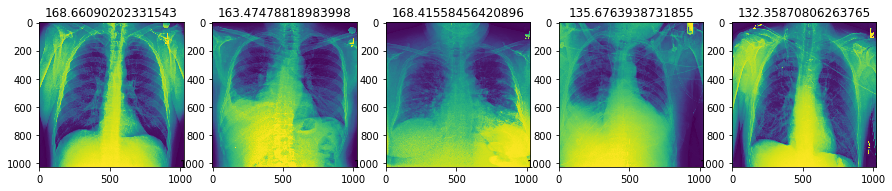

Length 715 PixelSpacing 0.19431099999999998


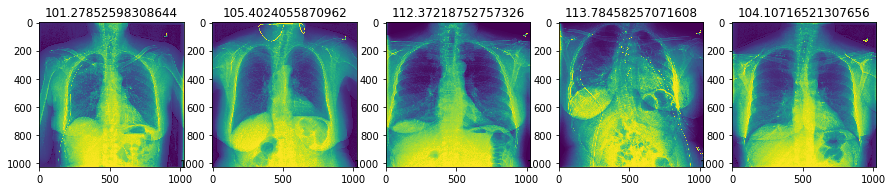

In [65]:
plots_per_group = 5
plot_height = 3
for PixelSpacing, index_list in df.reset_index().groupby("PixelSpacing")["index"].apply(list).items():
    # There around three groups which have small amount of images
    # and is not representable
    if len(index_list) < 15:
        continue

    print("Length", len(index_list), "PixelSpacing", PixelSpacing)
    plt.figure(figsize=(plot_height*plots_per_group, plot_height))
    for i in range(plots_per_group):
        random_index = np.random.choice(index_list)
        row = df.iloc[random_index]
        img = read_dcm(row["fp"])
#         mask = img != 0
#         img = img.astype(np.float)
        img = cv2.equalizeHist(img)
#         img_m = img[mask]
#         img[mask] = (img_m - img_m.mean()) / (img_m.std() + 1e-10)

        plt.subplot(1, plots_per_group, i+1)
        plt.title(row["mean_without_empty"])
        plt.imshow(img) #, cmap=plt.cm.bone)
    plt.show()


Length 283 PixelSpacing 0.139


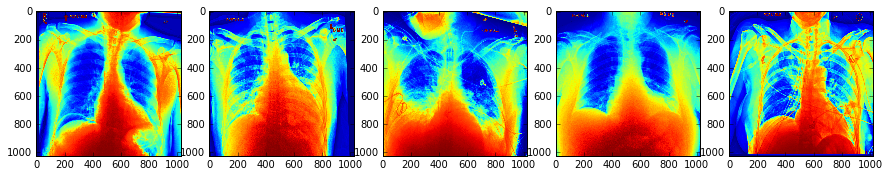

Length 463 PixelSpacing 0.14300000000000002


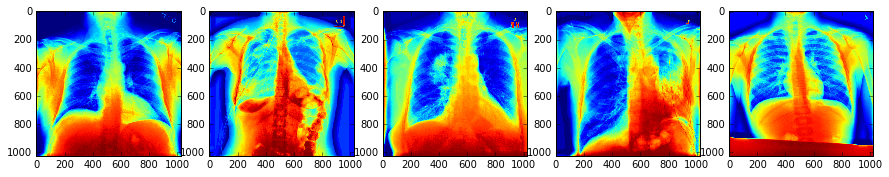

Length 451 PixelSpacing 0.168


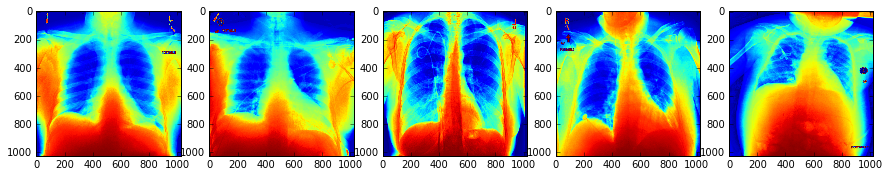

Length 100 PixelSpacing 0.171


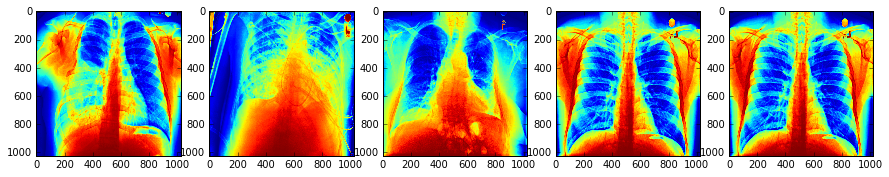

Length 76 PixelSpacing 0.19431099999999998


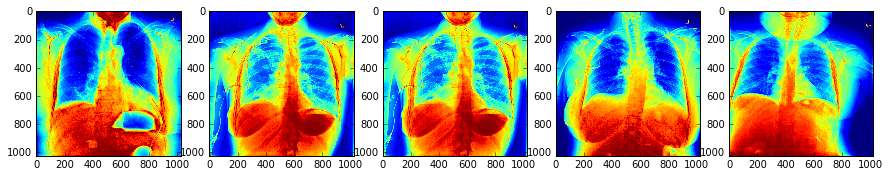

In [27]:
plots_per_group = 5
plot_height = 3
for PixelSpacing, index_list in df_test.reset_index().groupby("PixelSpacing")["index"].apply(list).items():
    # There around three groups which have small amount of images
    # and is not representable
    if len(index_list) < 15:
        continue

    print("Length", len(index_list), "PixelSpacing", PixelSpacing)
    plt.figure(figsize=(plot_height*plots_per_group, plot_height))
    for i in range(plots_per_group):
        random_index = np.random.choice(index_list)
        row = df_test.iloc[random_index]
        img = read_dcm(row["fp"])
#         mask = img != 0
#         img = img.astype(np.float)
        img = cv2.equalizeHist(img)
#         img_m = img[mask]
#         img[mask] = (img_m - img_m.mean()) / (img_m.std() + 1e-10)

        plt.subplot(1, plots_per_group, i+1)
#         plt.title(row["mean_without_empty"])
        plt.imshow(img) #, cmap=plt.cm.bone)
    plt.show()

Length 283 PixelSpacing 0.139
103.8527603149414 41.66093215178974 0 255
# 116.75262641906738 44.01182602880529 1 255
112.5549545288086 38.92777765539975 0 255
# 125.58812999725342 40.506196240559724 1 255
118.82862281799316 44.30792368920015 0 255
# 131.70686531066895 45.86634512204794 1 255
120.33859443664551 58.94072080089579 0 255
# 129.33287239074707 55.78737781155694 1 255
114.61318111419678 52.75886704986994 0 255
# 126.65473175048828 47.802480857934135 1 255


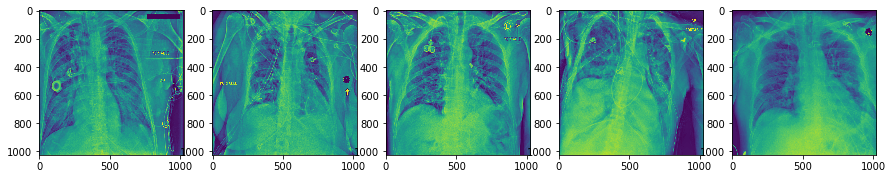

Length 463 PixelSpacing 0.14300000000000002
100.53888034820557 55.7034254230211 0 251
# 111.94165706634521 57.107397875537806 1 254
108.46710109710693 68.88187012158554 0 255
# 117.12408065795898 67.02343990550469 0 255
130.83667850494385 69.37244933913954 0 255
# 135.25044631958008 63.2192469366881 1 255
98.62402820587158 76.29426419158193 0 255
# 103.96457290649414 71.24702616026362 1 255
111.6922254562378 70.63665504132709 0 255
# 117.44907569885254 67.84522245185354 1 255


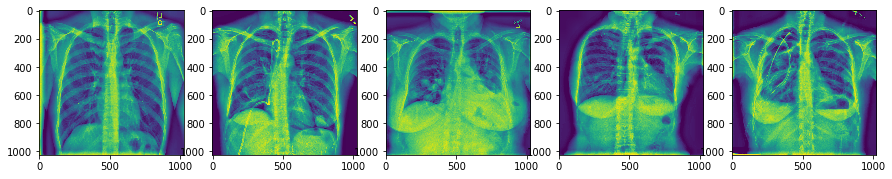

Length 451 PixelSpacing 0.168
114.86394691467285 53.3180357765235 0 223
# 126.6996660232544 47.132235762533185 1 228
139.99835872650146 72.2836125350185 0 255
# 135.4498987197876 70.86567120611232 2 255
151.9741907119751 52.131429742437554 0 239
# 154.79196643829346 51.209606113350034 0 241
157.4867706298828 61.844245977911456 0 255
# 149.70793056488037 61.51645724516544 2 255
90.86467933654785 101.06509163392086 0 255
# 90.31363296508789 96.84689557439549 0 255


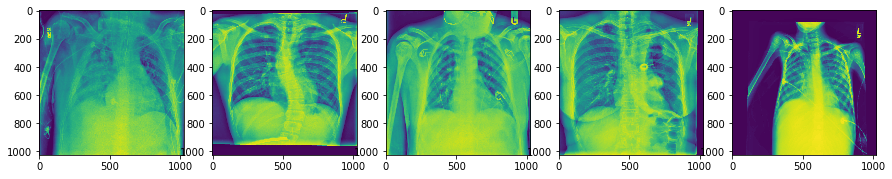

Length 100 PixelSpacing 0.171
133.5033016204834 44.94914046633469 0 245
# 139.83819103240967 45.84436668219705 1 252
153.23021030426025 52.902072674830286 17 232
# 150.33196258544922 53.812371849125064 5 247
139.3693618774414 59.932853897878985 0 229
# 140.2227954864502 60.701021779775964 1 244
97.60949611663818 70.34835217547158 0 233
# 108.00500297546387 69.23117376741145 1 238
129.84878540039062 56.11748117335769 0 227
# 137.6069040298462 55.10276316846116 2 240


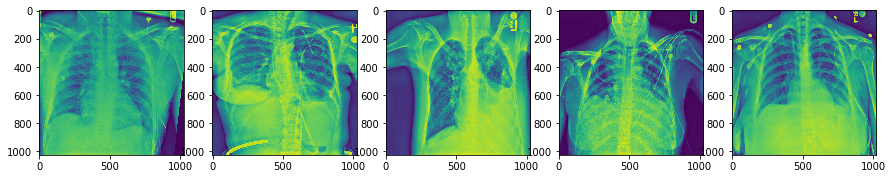

Length 76 PixelSpacing 0.19431099999999998
111.80010986328125 31.965248058211415 0 176
# 121.8010196685791 37.80629685080723 0 230
102.29211521148682 41.0490066288499 0 168
# 112.87036991119385 45.044901367848816 1 205
106.6212854385376 36.54102208811367 0 255
# 116.02939796447754 40.304105180631595 0 255
106.8195390701294 36.4710679667738 0 166
# 117.98293113708496 39.46023610909014 1 212
100.78837013244629 41.0023463812473 0 255
# 110.2298994064331 45.6187875551256 1 255


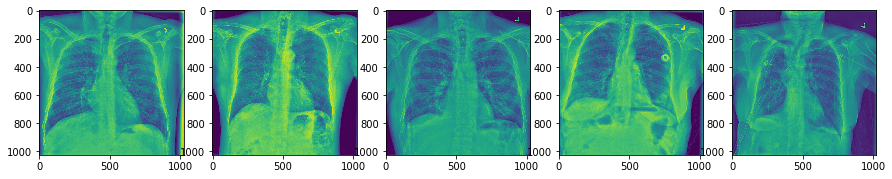

In [224]:
plots_per_group = 5
plot_height = 3
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(12,12))
for PixelSpacing, index_list in df_test.reset_index().groupby("PixelSpacing")["index"].apply(list).items():
    # There around three groups which have small amount of images
    # and is not representable
    if len(index_list) < 15:
        continue

    print("Length", len(index_list), "PixelSpacing", PixelSpacing)
    plt.figure(figsize=(plot_height*plots_per_group, plot_height))
    for i in range(plots_per_group):
        random_index = np.random.choice(index_list)
        row = df_test.iloc[random_index]
        img = read_dcm(row["fp"])
#         mask = img != 0
#         img = img.astype(np.float)
       
#         img = cv2.equalizeHist(img)
        print(img.mean(), img.std(), img.min(), img.max())
        img = clahe.apply(img)
        print("#", img.mean(), img.std(), img.min(), img.max())
        
#         img_m = img[mask]
#         img[mask] = (img_m - img_m.mean()) / (img_m.std() + 1e-10)

        plt.subplot(1, plots_per_group, i+1)
#         plt.title(row["mean_without_empty"])
        plt.imshow(img) #, cmap=plt.cm.bone)
    plt.show()

In [28]:
def nine_means(img):
    means = []
    pieces = 4
    step = (1024+pieces-1)//pieces
    k = 0
    for i in range(0, 1024, step):
        for j in range(0, 1024, step):
            patch = img[i: i+step, j:j+step]
            means.append(patch.mean())
            print(k, patch.min(), patch.max(), patch.mean())
            k += 1
    return means

In [29]:
pd.Series(img.flatten()).describe()

count    1.048576e+06
mean     1.021107e+02
std      4.021973e+01
min      0.000000e+00
25%      8.200000e+01
50%      1.130000e+02
75%      1.320000e+02
max      2.550000e+02
dtype: float64

In [60]:
def min_max(img):
    img = img.astype(np.float)
    return (img - img.min()) / (img.max() - img.min())
def standart(img):
    img = img.astype(np.float)
    return (img - img.mean()) / img.std()

In [53]:
((16*16)/((2900*1400)/(1024*1024)))**0.5

8.13124267188986

PixelSpacing 0.14300000000000002
[113.63483905792236, 127.3709602355957, 120.9638090133667]


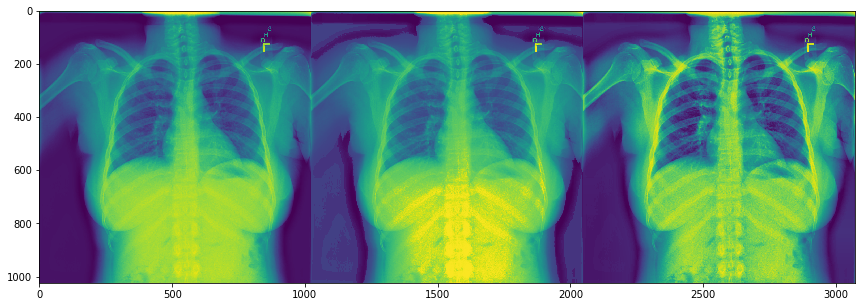

PixelSpacing 0.168
[112.35920238494873, 128.38928127288818, 125.07529163360596]


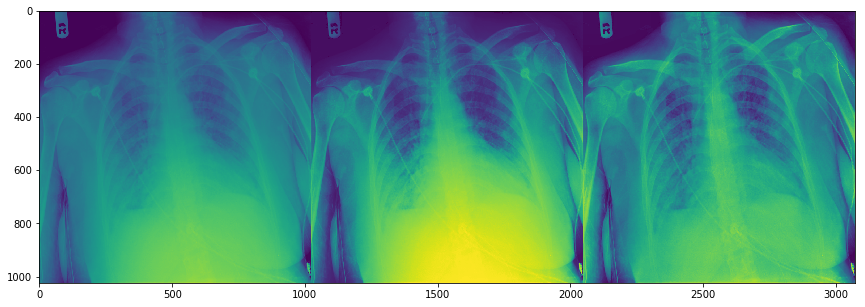

PixelSpacing 0.139
[126.89345741271973, 128.07478141784668, 136.63111305236816]


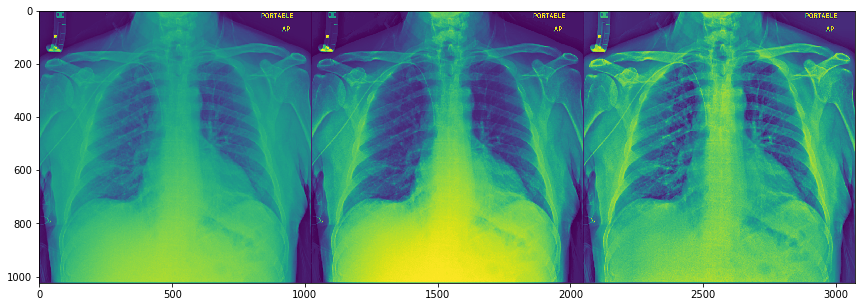

PixelSpacing 0.171
[140.06844329833984, 128.7556495666504, 145.21807098388672]


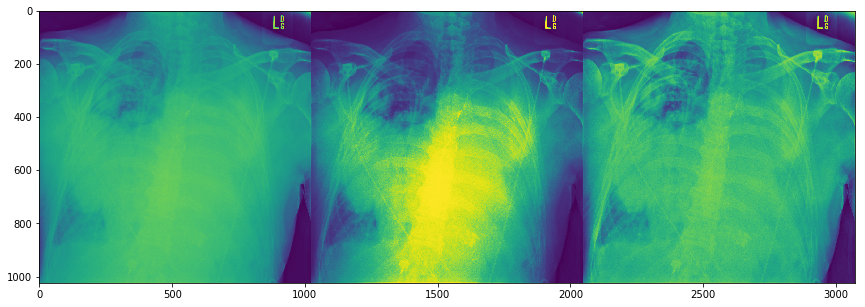

PixelSpacing 0.19431099999999998
[103.77628707885742, 120.11023998260498, 116.38112258911133]


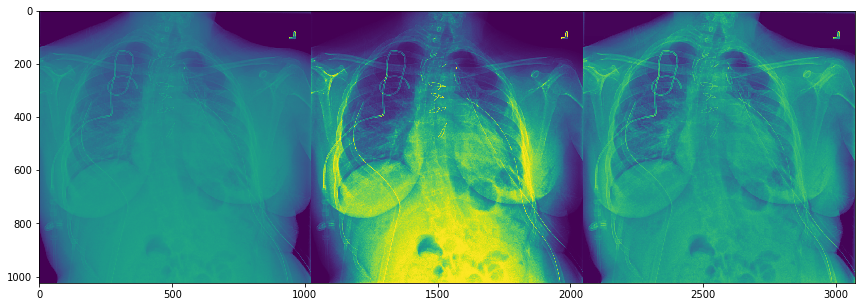

In [59]:
pixel_spacing_list = df.PixelSpacing.value_counts()
pixel_spacing_list = pixel_spacing_list[pixel_spacing_list.values > 18]
for PixelSpacing in pixel_spacing_list.index:
    for _, row in df[df.PixelSpacing == PixelSpacing].sample(1).iterrows():
        fp = row["fp"]
        in_img = read_dcm(fp) #.astype(np.float)
#         img = cv2.imread('wiki.jpg',0)
        equ1 = cv2.equalizeHist(in_img)
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
        equ = clahe.apply(in_img)
        means = [in_img.mean(), equ1.mean(), equ.mean()]
        img = np.hstack((in_img,equ1, equ))
    
#         img = min_max(img)
#         img = standart(img)
#         img = (img - img.mean()) / img.std()
        print("PixelSpacing", PixelSpacing)
        print(means)
        plt.figure(figsize=(20, 5))
#         plt.subplot(121)
        plt.imshow(img)
#         plt.subplot(122)
#         plt.hist(img.flatten(), range=(0, 255), bins=100)
        plt.show()


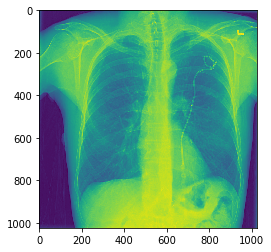

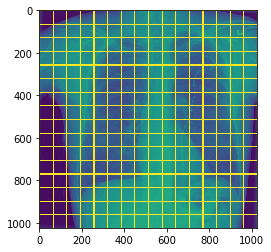

In [49]:
step = 1024 // 16
plt.imshow(in_img), plt.show()
in_copy = in_img.copy()
# for x in range(0, 1024, step):
#     for y in range(0, 1024, step):
#         if 400 > x > 200 and 650 > y > 200:
#             print(x, y)
#         plt.imshow(in_img[x:x+step, y:y+step]), plt.show()
#         in_img[x:x+5, y:y+2]
for x in range(0, 1024, step):
    in_copy[x:x+5] = 255
    in_copy[:, x:x+5] = 255
plt.imshow(in_copy)

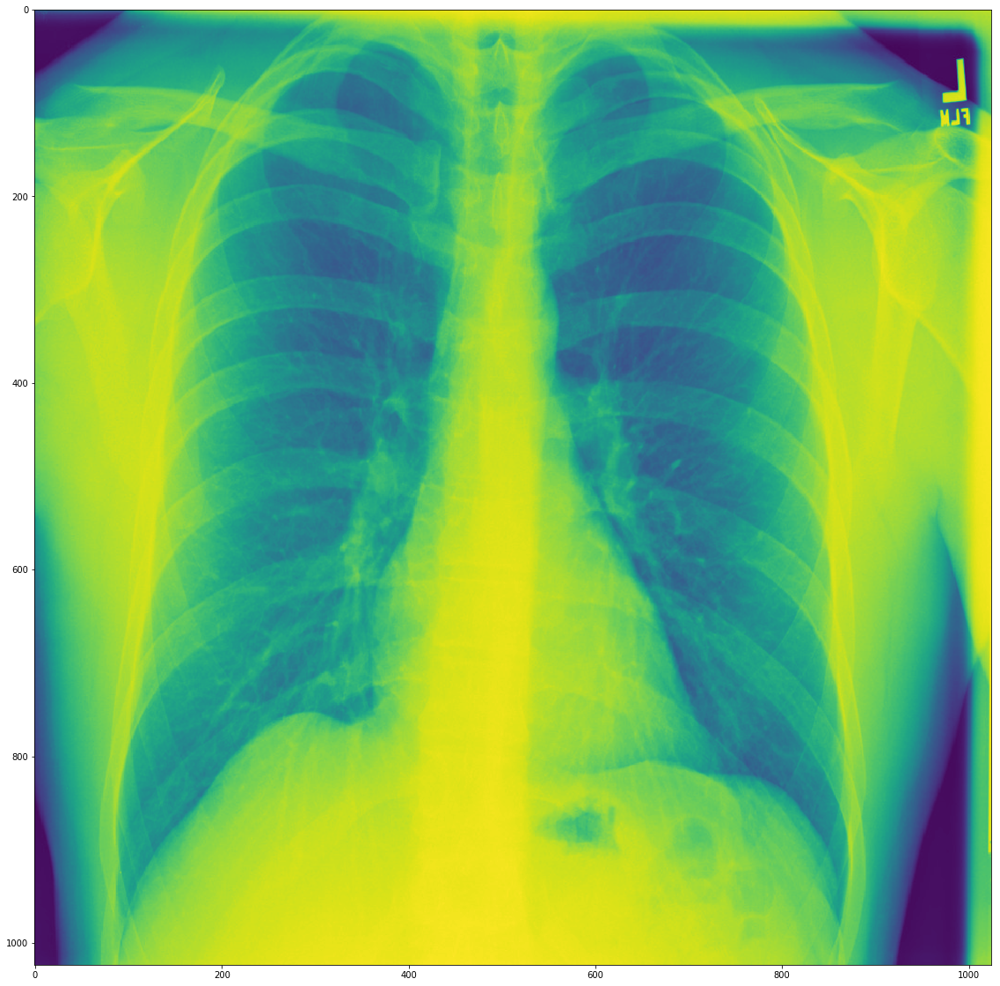

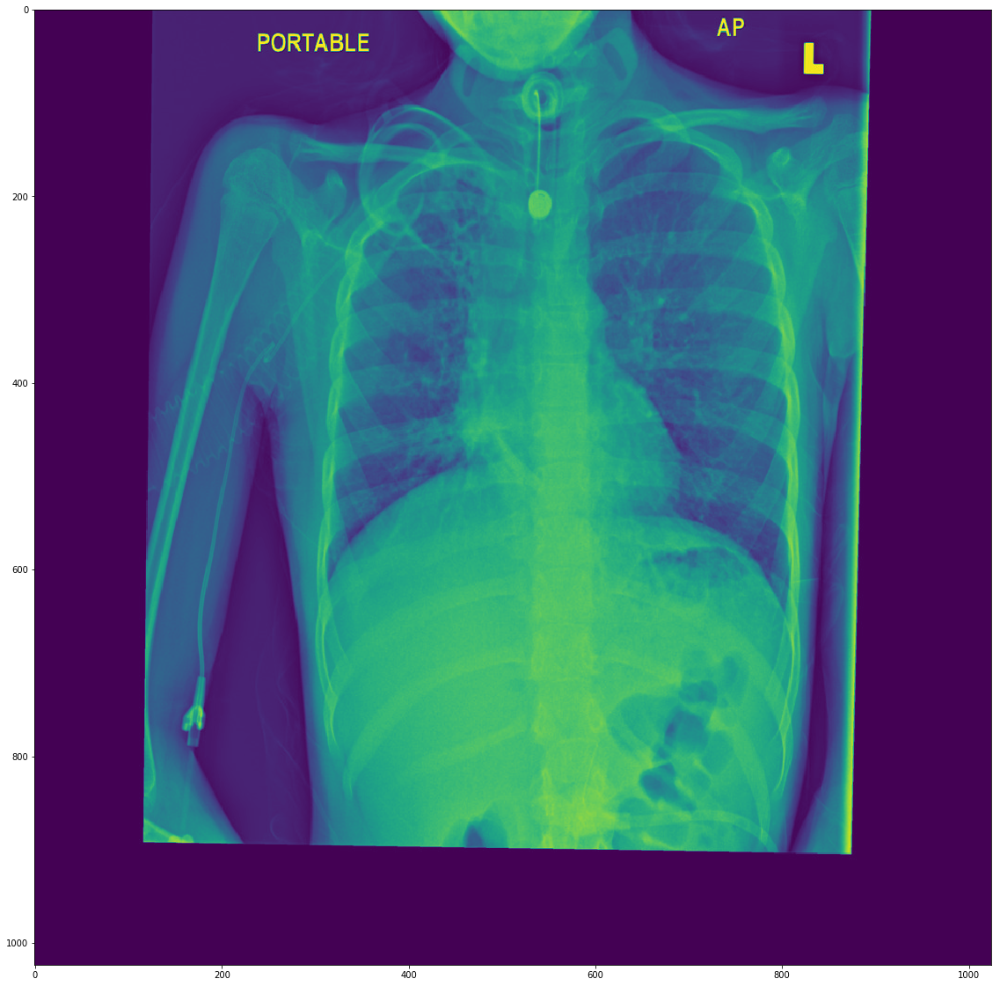

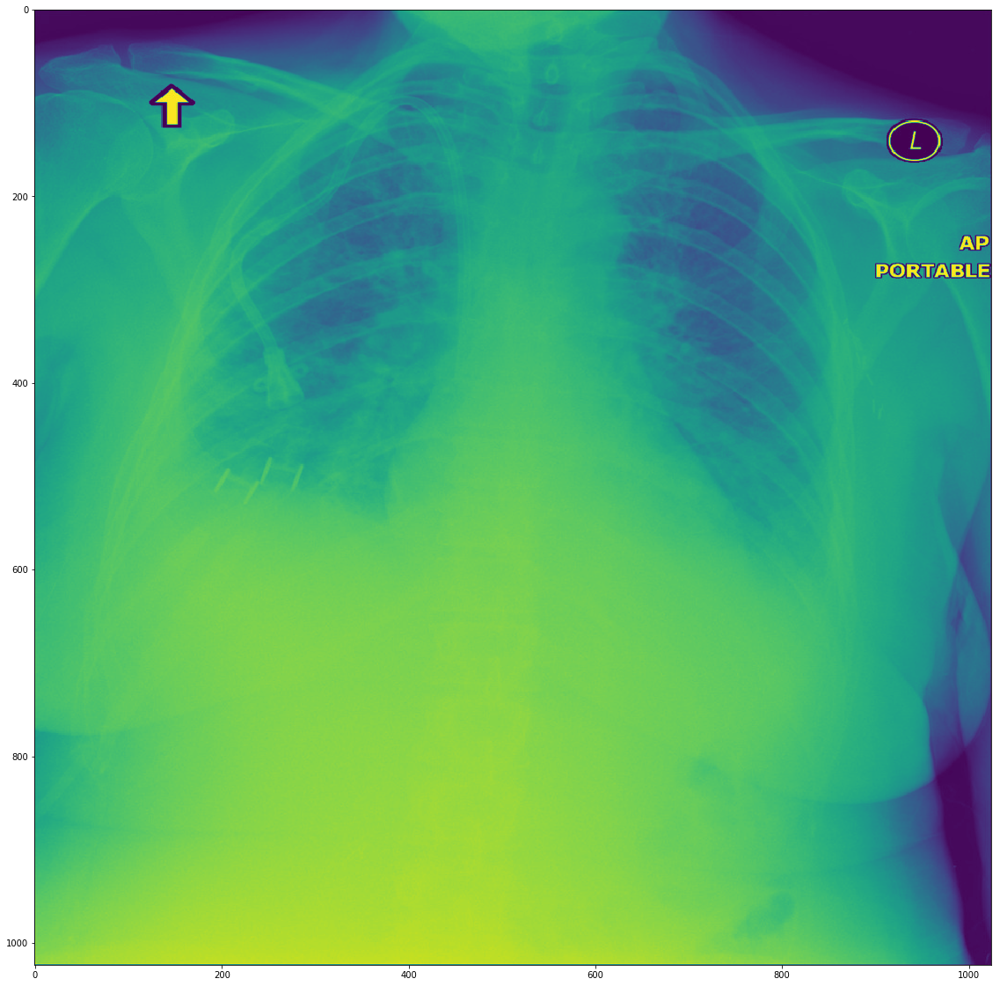

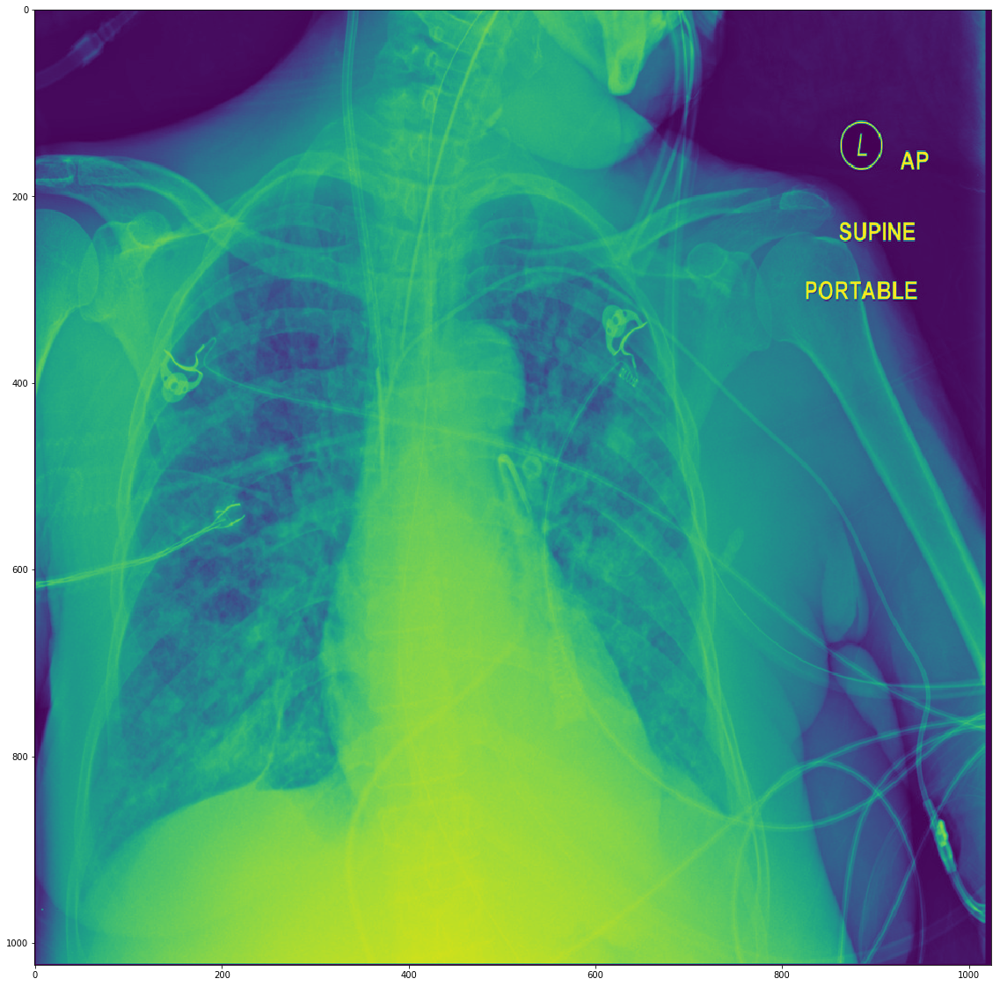

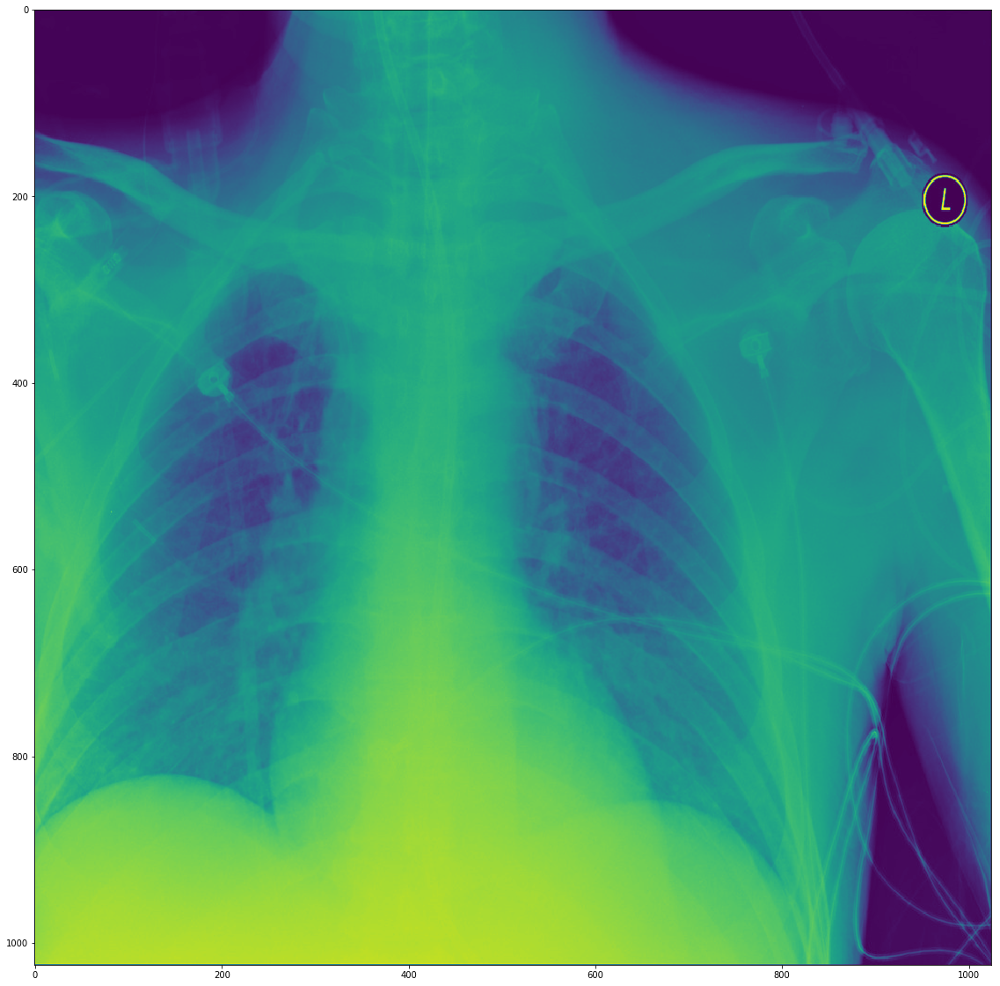

In [85]:
%matplotlib inline
for fp in df.fp.values[:5]:
    img = read_dcm(fp)
    plt.figure(figsize=(20, 20))
    plt.imshow(img)
    plt.show()

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10005.1517875220.958950/1.2.276.0.7230010.3.1.3.8323329.10005.1517875220.958949/1.2.276.0.7230010.3.1.4.8323329.10005.1517875220.958951.dcm


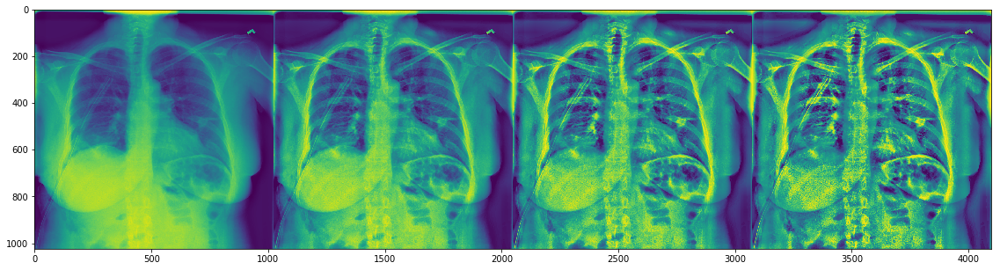

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10011.1517875220.977486/1.2.276.0.7230010.3.1.3.8323329.10011.1517875220.977485/1.2.276.0.7230010.3.1.4.8323329.10011.1517875220.977487.dcm


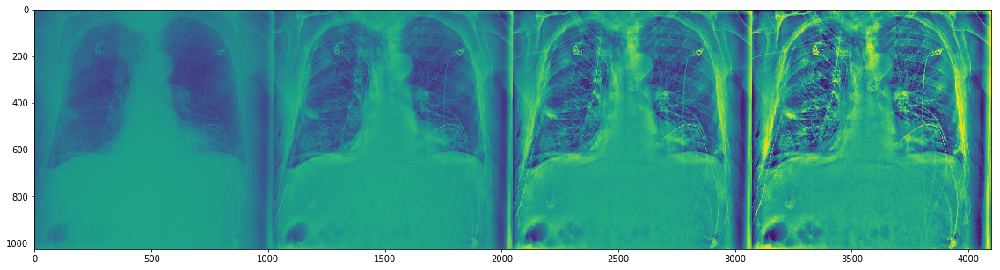

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10012.1517875220.965941/1.2.276.0.7230010.3.1.3.8323329.10012.1517875220.965940/1.2.276.0.7230010.3.1.4.8323329.10012.1517875220.965942.dcm


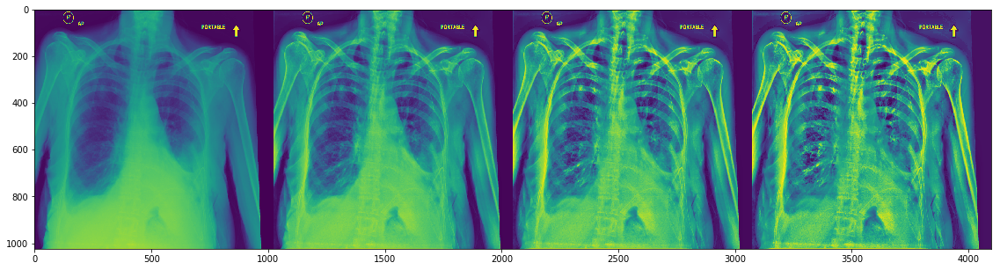

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10016.1517875220.992174/1.2.276.0.7230010.3.1.3.8323329.10016.1517875220.992173/1.2.276.0.7230010.3.1.4.8323329.10016.1517875220.992175.dcm


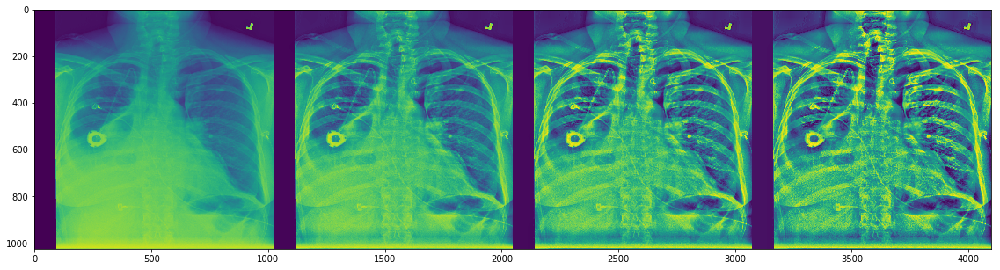

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10025.1517875221.19234/1.2.276.0.7230010.3.1.3.8323329.10025.1517875221.19233/1.2.276.0.7230010.3.1.4.8323329.10025.1517875221.19235.dcm


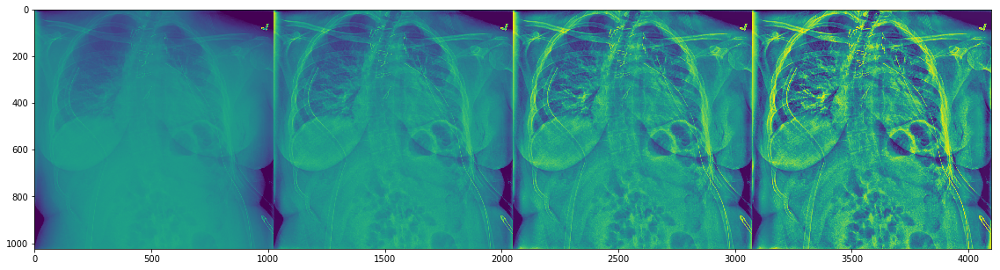

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10026.1517875221.22914/1.2.276.0.7230010.3.1.3.8323329.10026.1517875221.22913/1.2.276.0.7230010.3.1.4.8323329.10026.1517875221.22915.dcm


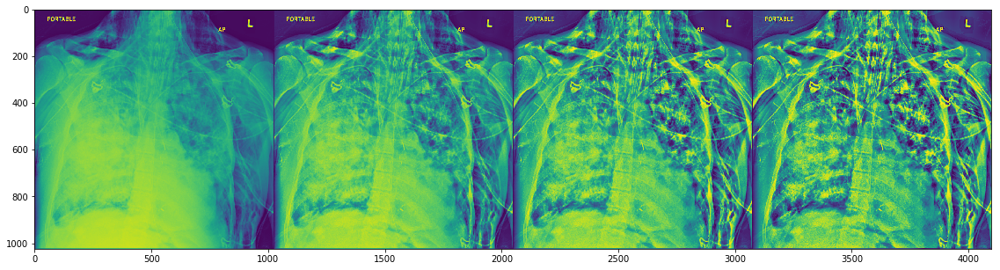

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10031.1517875221.31203/1.2.276.0.7230010.3.1.3.8323329.10031.1517875221.31202/1.2.276.0.7230010.3.1.4.8323329.10031.1517875221.31204.dcm


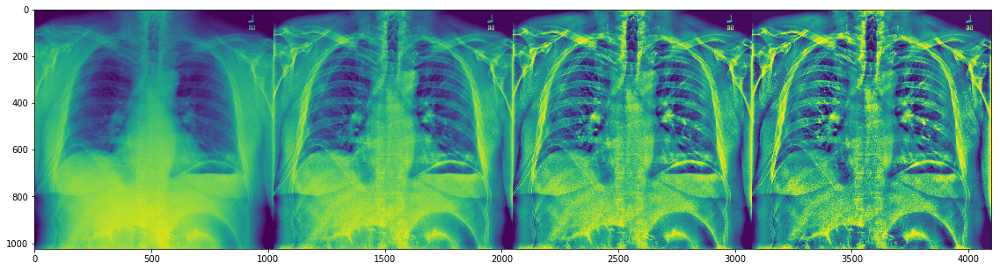

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10032.1517875221.34650/1.2.276.0.7230010.3.1.3.8323329.10032.1517875221.34649/1.2.276.0.7230010.3.1.4.8323329.10032.1517875221.34651.dcm


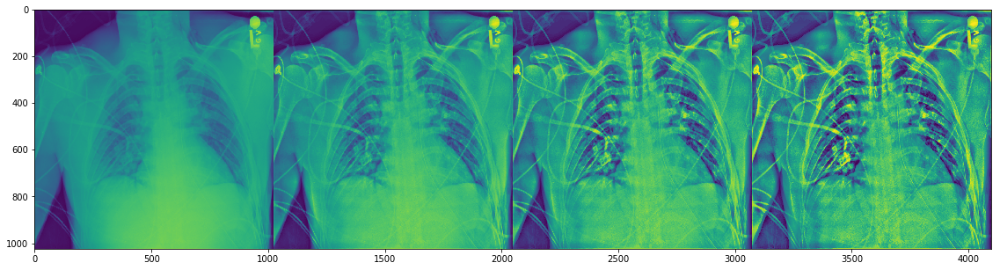

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10034.1517875221.47393/1.2.276.0.7230010.3.1.3.8323329.10034.1517875221.47392/1.2.276.0.7230010.3.1.4.8323329.10034.1517875221.47394.dcm


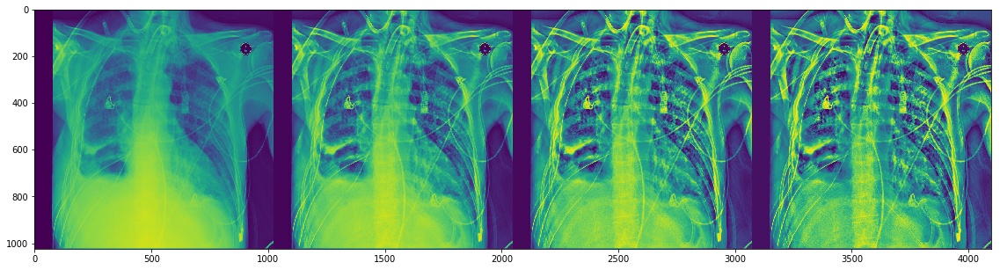

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10037.1517875221.677729/1.2.276.0.7230010.3.1.3.8323329.10037.1517875221.677728/1.2.276.0.7230010.3.1.4.8323329.10037.1517875221.677730.dcm


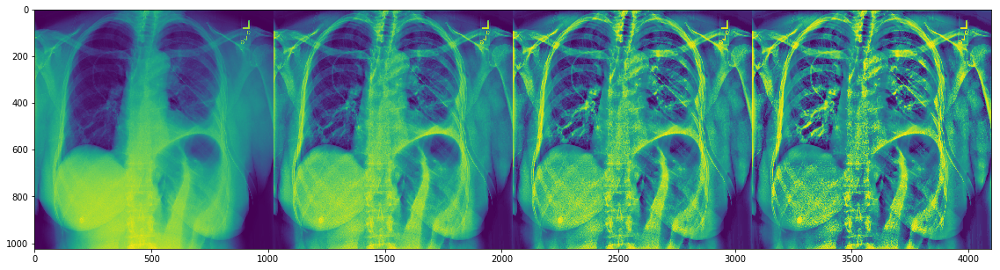

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10042.1517875221.699010/1.2.276.0.7230010.3.1.3.8323329.10042.1517875221.699009/1.2.276.0.7230010.3.1.4.8323329.10042.1517875221.699011.dcm


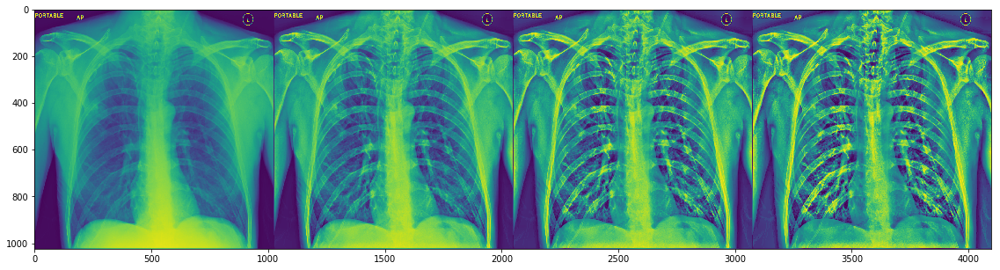

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10046.1517875221.743998/1.2.276.0.7230010.3.1.3.8323329.10046.1517875221.743997/1.2.276.0.7230010.3.1.4.8323329.10046.1517875221.743999.dcm


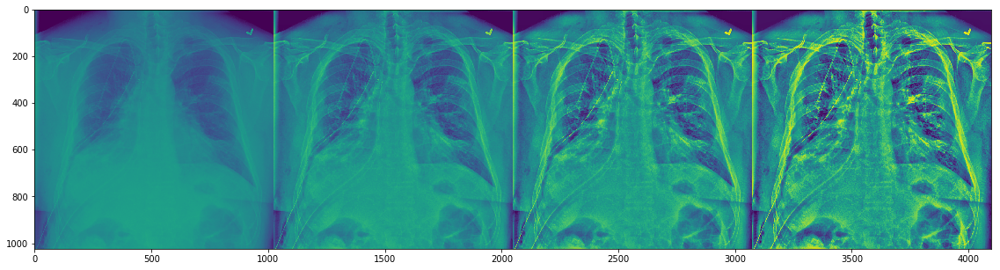

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10047.1517875221.722652/1.2.276.0.7230010.3.1.3.8323329.10047.1517875221.722651/1.2.276.0.7230010.3.1.4.8323329.10047.1517875221.722653.dcm


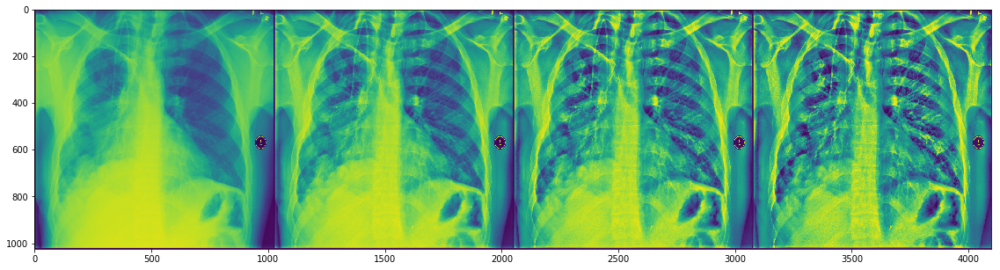

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10050.1517875221.763034/1.2.276.0.7230010.3.1.3.8323329.10050.1517875221.763033/1.2.276.0.7230010.3.1.4.8323329.10050.1517875221.763035.dcm


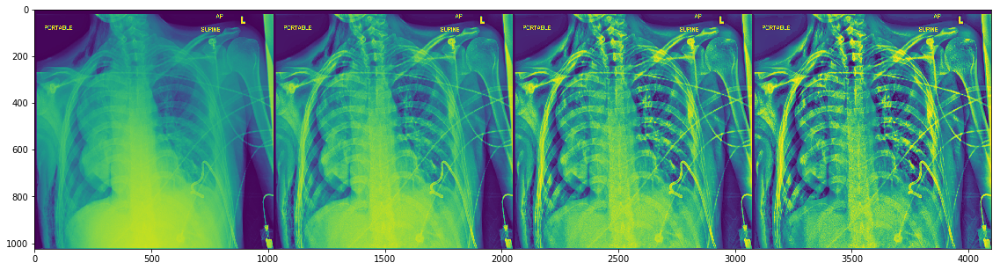

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10057.1517875221.791665/1.2.276.0.7230010.3.1.3.8323329.10057.1517875221.791664/1.2.276.0.7230010.3.1.4.8323329.10057.1517875221.791666.dcm


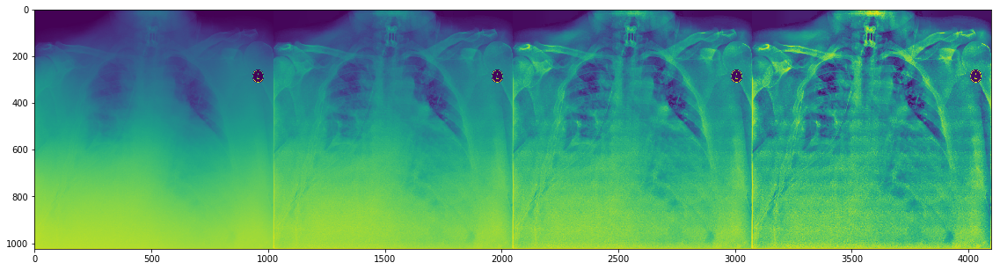

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10060.1517875221.792743/1.2.276.0.7230010.3.1.3.8323329.10060.1517875221.792742/1.2.276.0.7230010.3.1.4.8323329.10060.1517875221.792744.dcm


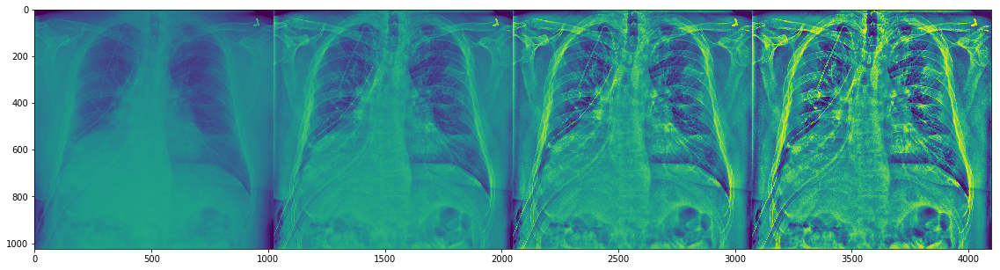

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10064.1517875221.817092/1.2.276.0.7230010.3.1.3.8323329.10064.1517875221.817091/1.2.276.0.7230010.3.1.4.8323329.10064.1517875221.817093.dcm


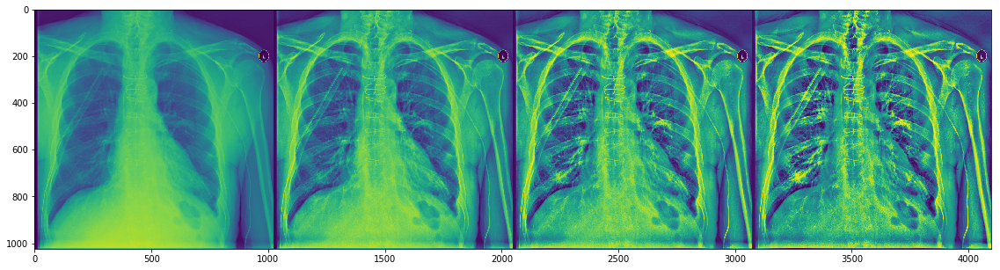

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10069.1517875221.825475/1.2.276.0.7230010.3.1.3.8323329.10069.1517875221.825474/1.2.276.0.7230010.3.1.4.8323329.10069.1517875221.825476.dcm


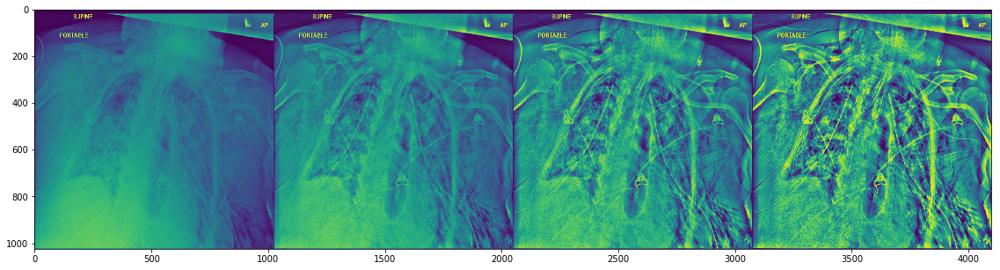

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10076.1517875221.859591/1.2.276.0.7230010.3.1.3.8323329.10076.1517875221.859590/1.2.276.0.7230010.3.1.4.8323329.10076.1517875221.859592.dcm


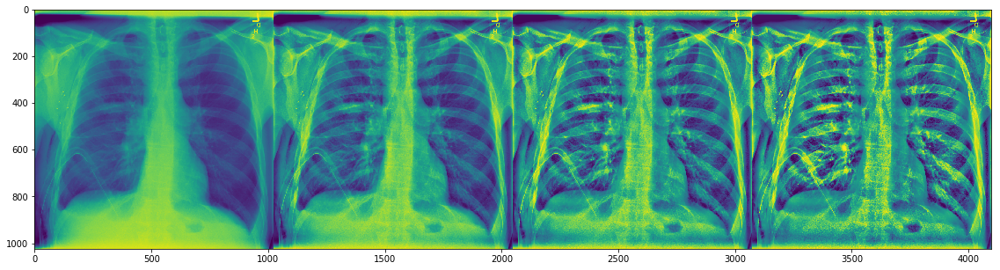

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10078.1517875221.860800/1.2.276.0.7230010.3.1.3.8323329.10078.1517875221.860799/1.2.276.0.7230010.3.1.4.8323329.10078.1517875221.860801.dcm


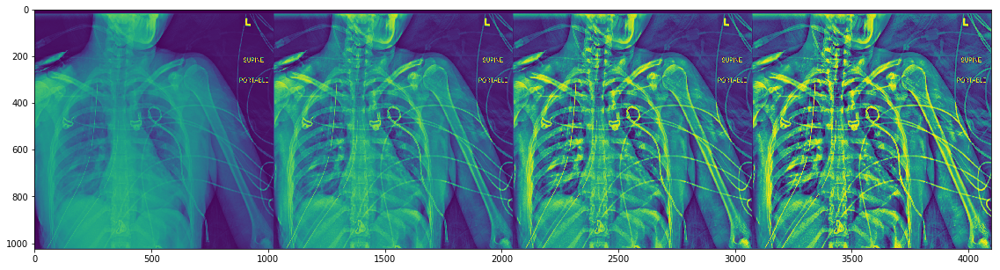

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10080.1517875221.874514/1.2.276.0.7230010.3.1.3.8323329.10080.1517875221.874513/1.2.276.0.7230010.3.1.4.8323329.10080.1517875221.874515.dcm


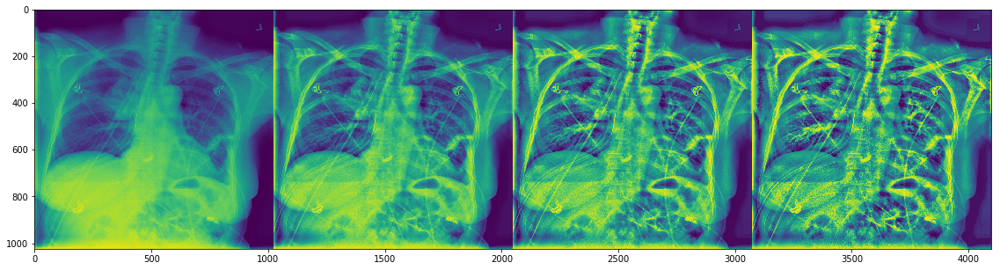

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10088.1517875221.907773/1.2.276.0.7230010.3.1.3.8323329.10088.1517875221.907772/1.2.276.0.7230010.3.1.4.8323329.10088.1517875221.907774.dcm


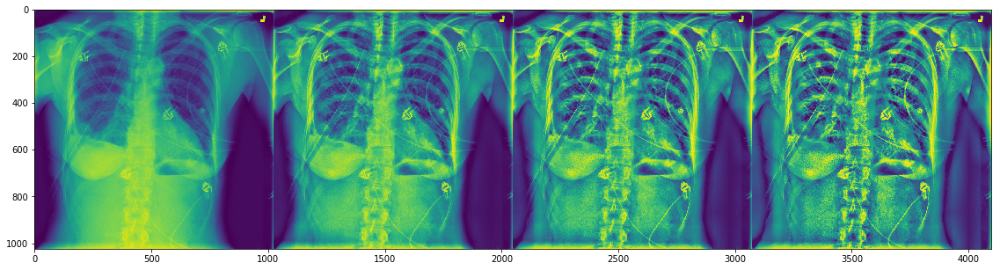

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10093.1517875221.950466/1.2.276.0.7230010.3.1.3.8323329.10093.1517875221.950465/1.2.276.0.7230010.3.1.4.8323329.10093.1517875221.950467.dcm


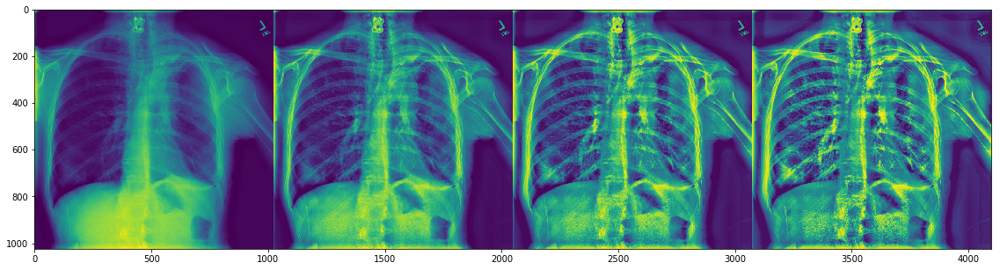

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10094.1517875221.969849/1.2.276.0.7230010.3.1.3.8323329.10094.1517875221.969848/1.2.276.0.7230010.3.1.4.8323329.10094.1517875221.969850.dcm


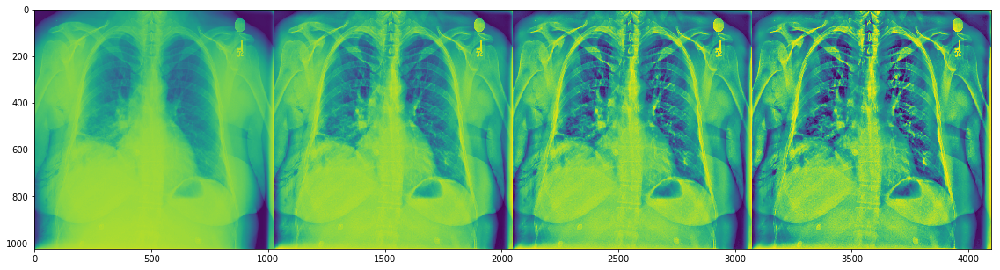

../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10095.1517875221.988308/1.2.276.0.7230010.3.1.3.8323329.10095.1517875221.988307/1.2.276.0.7230010.3.1.4.8323329.10095.1517875221.988309.dcm


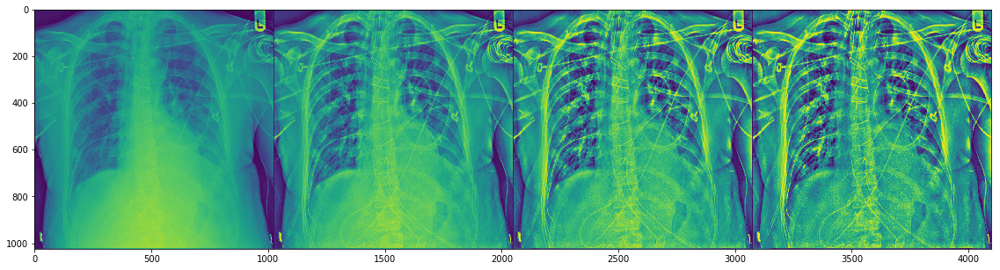

In [36]:
for i in range(25):
    fp = df[~df["empty"]]["fp"].values[i]
    print(fp)
    plt.figure(figsize=(20, 5))
    in_img = read_dcm(fp)
    chlae = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(16,16))
    equ1 = chlae.apply(in_img)
    chlae = cv2.createCLAHE(clipLimit=5.0, tileGridSize=(16,16))
    equ2 = chlae.apply(in_img)
    chlae = cv2.createCLAHE(clipLimit=10.0, tileGridSize=(16,16))
    equ3 = chlae.apply(in_img)
    out_img = np.hstack([in_img, equ1, equ2, equ3])
    plt.imshow(out_img), plt.show()

In [60]:
means = []
stds = []
cv2.createCLAHE(clipLimit=2.0, tileGridSize=(16,16))
for fp in tqdm(df["fp"].values):
    in_img = read_dcm(fp)
    in_img = chlae.apply(in_img)
    means.append(in_img.mean())
    stds.append(in_img.std())
print(np.mean(means), np.mean(stds))


130.70300678664125 57.0585038384225


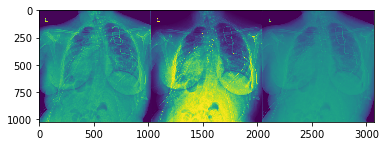

In [76]:
plt.imshow(img[:, ::-1])

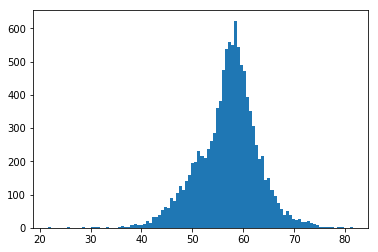

In [63]:
plt.hist(stds, bins=100);

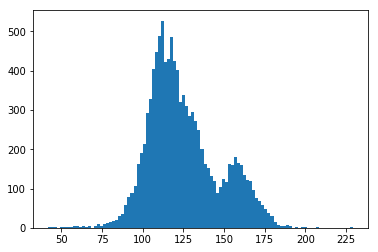

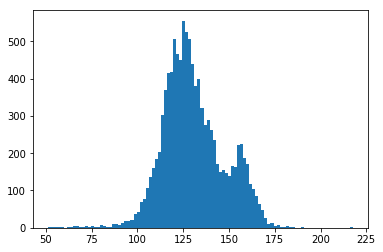

In [28]:
plt.hist(b_means, bins=100); plt.show()
plt.hist(a_means, bins=100); plt.show()

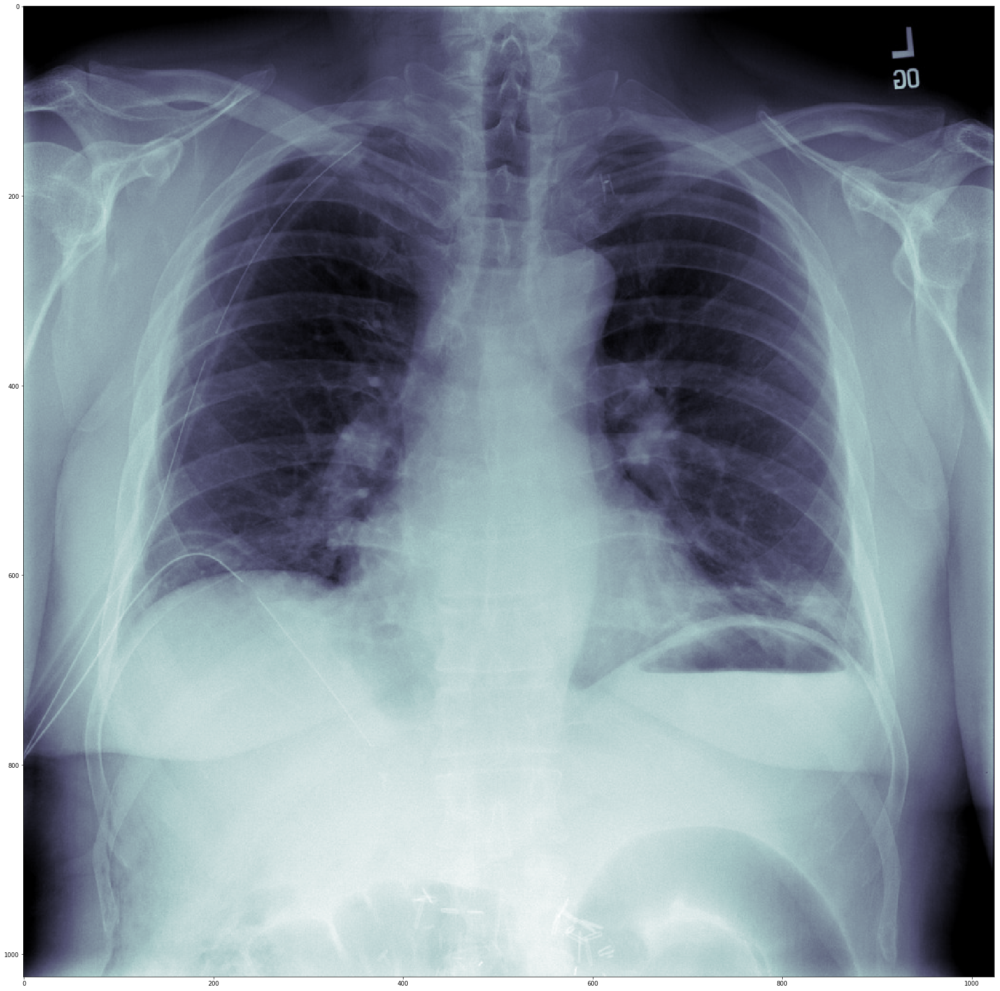

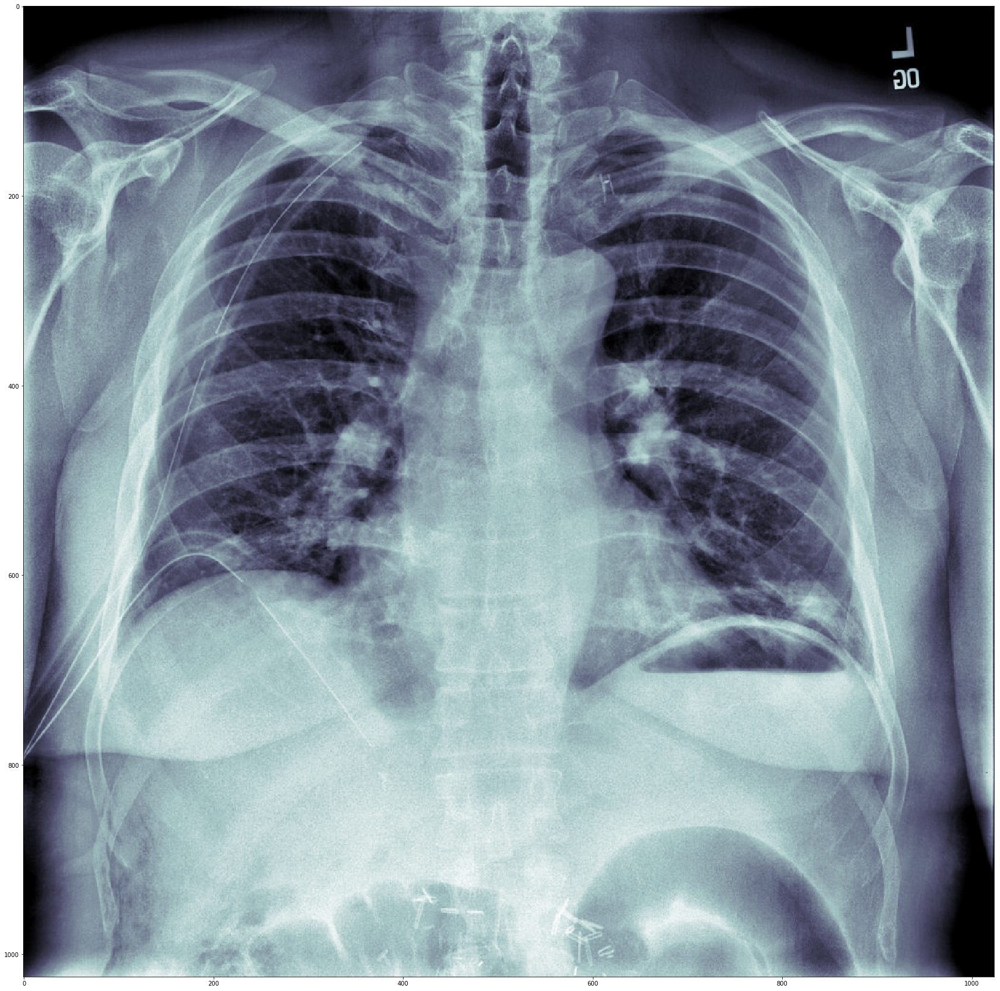

In [31]:
fp = "../data/raw/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10031.1517875221.31203/1.2.276.0.7230010.3.1.3.8323329.10031.1517875221.31202/1.2.276.0.7230010.3.1.4.8323329.10031.1517875221.31204.dcm"
in_img = read_dcm(fp)
plt.figure(figsize=(30, 30))
plt.imshow(in_img, cmap="bone"), plt.show()
chlae = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(12,12))
applied = chlae.apply(in_img)
plt.figure(figsize=(30, 30))
plt.imshow(applied, cmap="bone")

MEAN 112.52911949157715


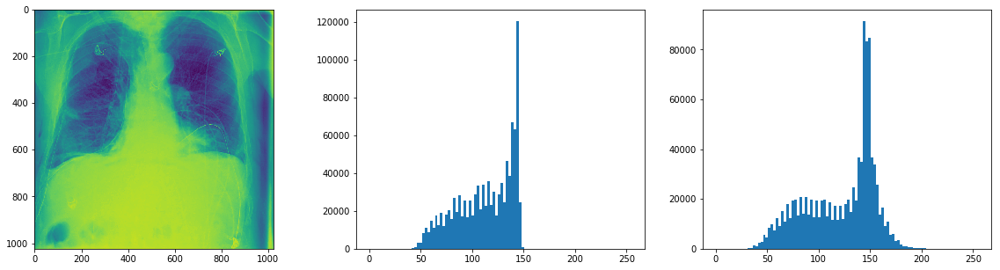

MEAN 111.8761568069458


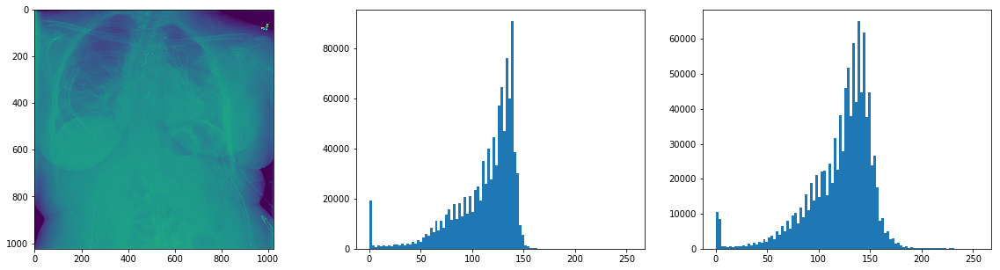

In [244]:
for fp in df[df.PixelSpacing == "0.19431099999999998"].fp.values[[0, 2]]:
    img = read_dcm(fp).astype(np.int)
    print("MEAN", np.mean(img))
    plt.figure(figsize=(20, 5))
    plt.subplot(131)
    plt.imshow(img)
    plt.subplot(132)
    plt.hist(img.flatten(), range=(0, 255), bins=100)
    plt.subplot(133)
    plt.hist(clahe.apply(img.astype(np.uint8)).flatten(), range=(0, 255), bins=100)
    
    plt.show()

# Time to work with test_data

In [36]:
!ls ../data/siim-dataset/

dicom-images-test   download_images.py	 train-rle.csv
dicom-images-train  load_annotations.sh


In [37]:
df_test = pd.DataFrame(dict(fp=list(_iterate_dcm_dir("../data/siim-dataset/dicom-images-test"))))

In [38]:
df_test.shape

(1377, 1)

In [39]:
df_test["ImageId"] = df_test.fp.apply(lambda x: os.path.splitext(os.path.basename(x))[0])

(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0016) SOP Class UID                       UI: Secondary Capture Image Storage
(0008, 0018) SOP Instance UID                    UI: 1.2.276.0.7230010.3.1.4.8323329.5918.1517875192.589345
(0008, 0020) Study Date                          DA: '19010101'
(0008, 0030) Study Time                          TM: '000000.00'
(0008, 0050) Accession Number                    SH: ''
(0008, 0060) Modality                            CS: 'CR'
(0008, 0064) Conversion Type                     CS: 'WSD'
(0008, 0090) Referring Physician's Name          PN: ''
(0008, 103e) Series Description                  LO: 'view: PA'
(0010, 0010) Patient's Name                      PN: '8b5e36fe-3916-41f2-8d62-894d554c64c4'
(0010, 0020) Patient ID                          LO: '8b5e36fe-3916-41f2-8d62-894d554c64c4'
(0010, 0030) Patient's Birth Date                DA: ''
(0010, 0040) Patient's Sex                       CS: 'F'
(0010, 1010) Patient's

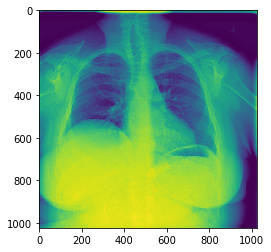

(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0016) SOP Class UID                       UI: Secondary Capture Image Storage
(0008, 0018) SOP Instance UID                    UI: 1.2.276.0.7230010.3.1.4.8323329.5887.1517875192.188287
(0008, 0020) Study Date                          DA: '19010101'
(0008, 0030) Study Time                          TM: '000000.00'
(0008, 0050) Accession Number                    SH: ''
(0008, 0060) Modality                            CS: 'CR'
(0008, 0064) Conversion Type                     CS: 'WSD'
(0008, 0090) Referring Physician's Name          PN: ''
(0008, 103e) Series Description                  LO: 'view: AP'
(0010, 0010) Patient's Name                      PN: '501d93dc-ab1a-4a37-a135-f11cac76153b'
(0010, 0020) Patient ID                          LO: '501d93dc-ab1a-4a37-a135-f11cac76153b'
(0010, 0030) Patient's Birth Date                DA: ''
(0010, 0040) Patient's Sex                       CS: 'M'
(0010, 1010) Patient's

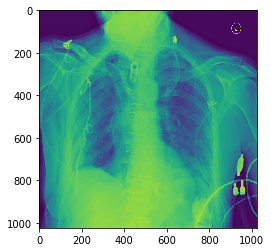

In [40]:
for fp in df_test.fp.head(2).values:
    img = read_dcm(fp, v=1)
    plt.imshow(img); plt.show()

### Empty values diagnostic

In [41]:
def find_empty_job(fp):
    return (read_dcm(fp) == 0).sum()

df_test["empty_area"] = parallel_wrapper(df_test.fp.values, find_empty_job)

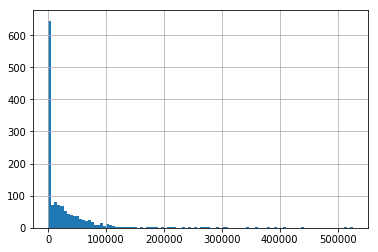

In [42]:
df_test.empty_area.hist(bins=100)

In [43]:
(df_test.empty_area > 150000).sum()

35

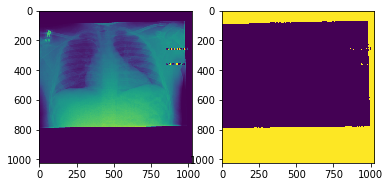

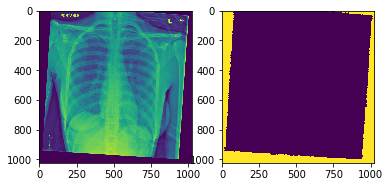

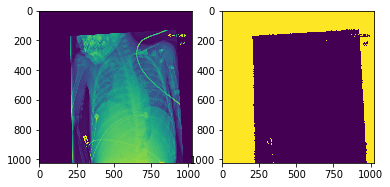

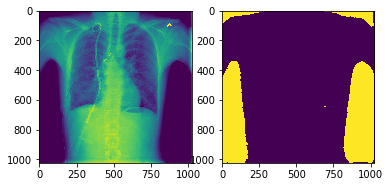

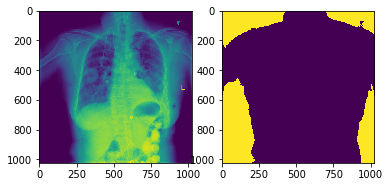

...

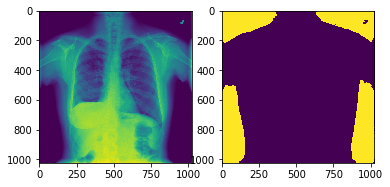

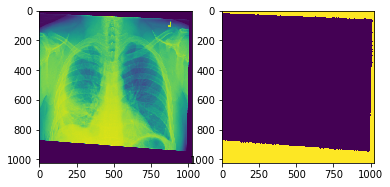

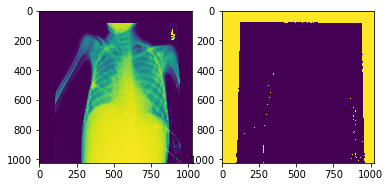

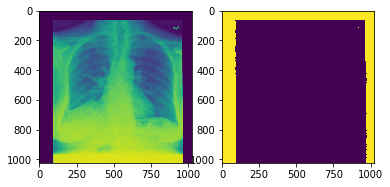

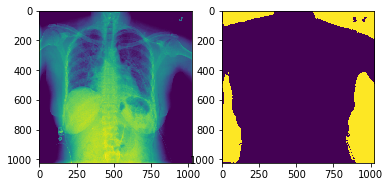

In [44]:
for _, row in df_test[df_test.empty_area > 150000].iterrows():
    fp = row["fp"]
    img = read_dcm(fp)
    plt.subplot(121)
    plt.imshow(img)
    plt.subplot(122)
    plt.imshow(img == 0)
    plt.show()

## extend test dataframe with metadata

In [76]:
df_test.index = range(len(df_test))
new_df = defaultdict(list)
for i, fp in tqdm(enumerate(df_test.fp.values)):
    ds = pydicom.read_file(fp)
    for field in fields_of_interest:
        value = getattr(ds, field)
        if type(value) == pydicom.multival.MultiValue:
            value = value[0]
        new_df[field].append(value)
for field, values in new_df.items():
    df_test[field] = np.array(values, dtype=str)


In [77]:
df_test["PatientAge"] = df_test.PatientAge.astype(np.int)

## PixelSpacing groups distribution

In [78]:
print(df_test.PixelSpacing.value_counts())
print(df_test.PixelSpacing.value_counts(normalize=True))

0.14300000000000002    463
0.168                  451
0.139                  283
0.171                  100
0.19431099999999998     76
0.19430799999999998      2
0.19431400000000001      2
Name: PixelSpacing, dtype: int64
0.14300000000000002    0.336238
0.168                  0.327524
0.139                  0.205519
0.171                  0.072622
0.19431099999999998    0.055192
0.19430799999999998    0.001452
0.19431400000000001    0.001452
Name: PixelSpacing, dtype: float64


### Sex distribution

In [79]:
df_test.PatientSex.value_counts(normalize=1)

M    0.542484
F    0.457516
Name: PatientSex, dtype: float64

PatientAge:34 PatientSex:F


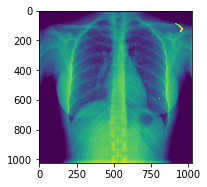

PatientAge:20 PatientSex:M


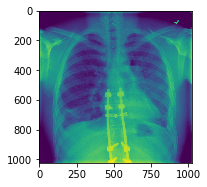

PatientAge:49 PatientSex:F


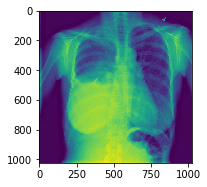

PatientAge:44 PatientSex:M


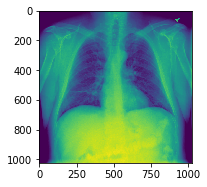

PatientAge:45 PatientSex:F


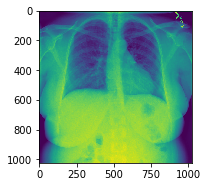

In [80]:
filter_mask = df_test.PixelSpacing == "0.14300000000000002"
plot(df_test[filter_mask], 5, False, ["PatientAge", "PatientSex"])

## Use data leakage to find out distribution of `empty` based on `PixelSpacing`

In [81]:
_temp = pd.read_csv("sample_submission.csv").groupby("ImageId").count()
_temp["empty"] = _temp["EncodedPixels"] == 1

In [82]:
_temp.head()

,EncodedPixels,empty
ImageId,,
1.2.276.0.7230010.3.1.4.8323329.5797.1517875190.762694,2,False
1.2.276.0.7230010.3.1.4.8323329.5798.1517875190.796716,1,True
1.2.276.0.7230010.3.1.4.8323329.5799.1517875190.806810,1,True
1.2.276.0.7230010.3.1.4.8323329.580.1517875163.537053,1,True
1.2.276.0.7230010.3.1.4.8323329.5800.1517875190.832691,1,True


In [83]:
_temp["empty"].value_counts(normalize=True)

True     0.943149
False    0.056851
Name: empty, dtype: float64

In [84]:
df_test.loc[:, "empty"] = df_test.ImageId.isin(_temp[_temp["empty"]].index)

In [85]:
df["empty"].mean()

0.7771428571428571

In [86]:
df_test["empty"].mean()

0.9397240377632534

In [87]:
df_test["empty"].mean(), (~df_test["empty"]).sum()

(0.9397240377632534, 83)

In [88]:
df_test.ViewPosition.value_counts()

PA    783
AP    594
Name: ViewPosition, dtype: int64

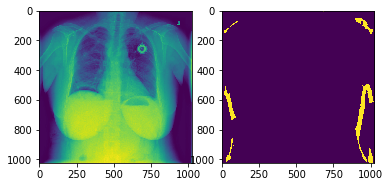

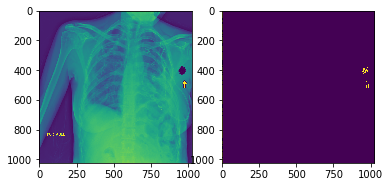

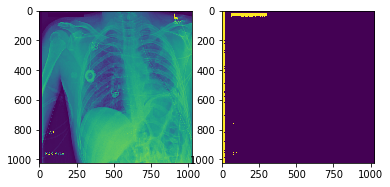

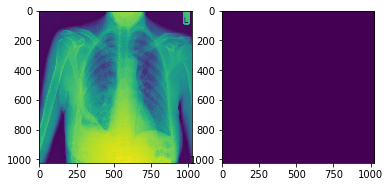

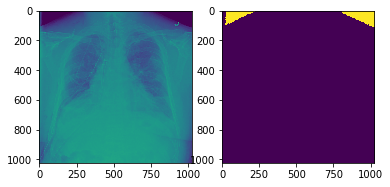

In [102]:
sorted_by_empty_area = df_test.iloc[np.argsort(df_test["empty"].values)[::-1]]
for _, row in sorted_by_empty_area[(~sorted_by_empty_area["empty"])].head(5).iterrows():
    fp = row["fp"]
    img = read_dcm(fp)
    plt.subplot(121)
    plt.imshow(img)
    plt.subplot(122)
    plt.imshow(img == 0)
    plt.show()


# Correspondense PixelSpacing Pos/Neg

In [125]:
SpacingToCount = ["0.139",              
"0.14300000000000002",
"0.168"              ,
"0.171"              ,
"0.19430799999999998",
"0.19431099999999998",
"0.19431400000000001",]

In [127]:
sample_df = df.PixelSpacing.value_counts().sort_index()
sample_df = sample_df[sample_df.index.isin(SpacingToCount)]
print(sample_df)
sample_df = df.PixelSpacing.value_counts(normalize=True).sort_index()
sample_df = sample_df[sample_df.index.isin(SpacingToCount)]
print(sample_df)

0.139                  1966
0.14300000000000002    3966
0.168                  3213
0.171                   785
0.19430799999999998      10
0.19431099999999998     715
0.19431400000000001      14
Name: PixelSpacing, dtype: int64
0.139                  0.184169
0.14300000000000002    0.371522
0.168                  0.300984
0.171                  0.073536
0.19430799999999998    0.000937
0.19431099999999998    0.066979
0.19431400000000001    0.001311
Name: PixelSpacing, dtype: float64


In [128]:
sample_df = df.groupby("PixelSpacing")["empty"].apply(list).sort_index()
sample_df = sample_df[sample_df.index.isin(SpacingToCount)]
# sample_df = sample_df[sample_df.apply(len) > 16]
print(sample_df.apply(len) - sample_df.apply(np.sum))
print(1 - sample_df.apply(np.mean))

PixelSpacing
0.139                  520
0.14300000000000002    995
0.168                  470
0.171                  119
0.19430799999999998      4
0.19431099999999998    263
0.19431400000000001      6
Name: empty, dtype: int64
PixelSpacing
0.139                  0.264496
0.14300000000000002    0.250883
0.168                  0.146281
0.171                  0.151592
0.19430799999999998    0.400000
0.19431099999999998    0.367832
0.19431400000000001    0.428571
Name: empty, dtype: float64


In [120]:
sample_df = df_test.PixelSpacing.value_counts().sort_index()
# sample_df = sample_df[sample_df > 5]
print(sample_df)
sample_df = df_test.PixelSpacing.value_counts(normalize=True)
# sample_df = sample_df[sample_df > 0.01]
print(sample_df)

0.139                  283
0.14300000000000002    463
0.168                  451
0.171                  100
0.19430799999999998      2
0.19431099999999998     76
0.19431400000000001      2
Name: PixelSpacing, dtype: int64
0.14300000000000002    0.336238
0.168                  0.327524
0.139                  0.205519
0.171                  0.072622
0.19431099999999998    0.055192
0.19430799999999998    0.001452
0.19431400000000001    0.001452
Name: PixelSpacing, dtype: float64


In [121]:
sample_df = df_test.groupby("PixelSpacing")["empty"].apply(list).sort_index()
# sample_df = sample_df[sample_df.apply(len) > 5]
print(sample_df.apply(len) - sample_df.apply(np.sum))
print(1 - sample_df.apply(np.mean))

PixelSpacing
0.139                  29
0.14300000000000002    32
0.168                  11
0.171                   3
0.19430799999999998     1
0.19431099999999998     7
0.19431400000000001     0
Name: empty, dtype: int64
PixelSpacing
0.139                  0.102473
0.14300000000000002    0.069114
0.168                  0.024390
0.171                  0.030000
0.19430799999999998    0.500000
0.19431099999999998    0.092105
0.19431400000000001    0.000000
Name: empty, dtype: float64


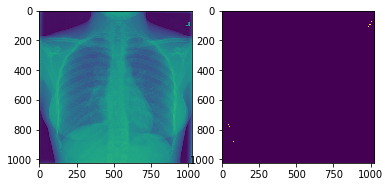

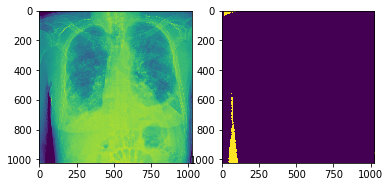

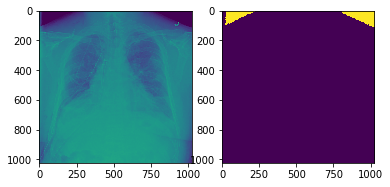

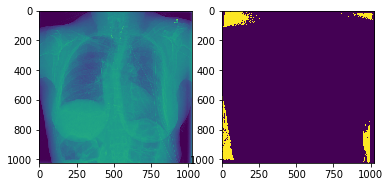

In [129]:
sample_df = df_test[df_test.PixelSpacing.isin(["0.19430799999999998","0.19431400000000001"])]
for _, row in sample_df.iterrows():
    fp = row["fp"]
    img = read_dcm(fp)
    plt.subplot(121)
    plt.imshow(img)
    plt.subplot(122)
    plt.imshow(img == 0)
    plt.show()

In [161]:
import scipy.ndimage

In [185]:
def resample(image, scan, old_spacing, new_spacing):
    # Determine current pixel spacing
    spacing = old_spacing
    
    resize_factor = spacing / new_spacing
    new_real_shape = np.array(image.shape) * resize_factor
    print(new_real_shape, resize_factor)
    new_shape = np.round(new_real_shape)
    real_resize_factor = new_shape / image.shape
    new_spacing = spacing / real_resize_factor
    
    image = scipy.ndimage.interpolation.zoom(image, real_resize_factor, mode='nearest')
    
    return image, new_spacing

In [186]:
df.PixelSpacing.unique()

array(['0.168', '0.139', '0.171', '0.14300000000000002',
       '0.19431099999999998', '0.19430799999999998',
       '0.19431400000000001', '0.19433599999999998', '0.193754', '0.115',
       '0.19378399999999998'], dtype=object)

../data/siim-dataset/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.1000.1517875165.878026/1.2.276.0.7230010.3.1.3.8323329.1000.1517875165.878025/1.2.276.0.7230010.3.1.4.8323329.1000.1517875165.878027.dcm
0.168
[1024. 1024.] 1.0
(1024, 1024)


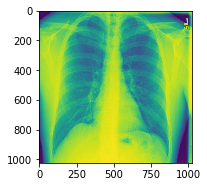

../data/siim-dataset/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10000.1517875220.938529/1.2.276.0.7230010.3.1.3.8323329.10000.1517875220.938528/1.2.276.0.7230010.3.1.4.8323329.10000.1517875220.938530.dcm
0.139
[847.23809524 847.23809524] 0.8273809523809524
(847, 847)


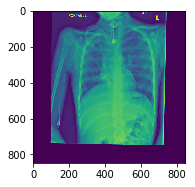

../data/siim-dataset/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10004.1517875220.929536/1.2.276.0.7230010.3.1.3.8323329.10004.1517875220.929535/1.2.276.0.7230010.3.1.4.8323329.10004.1517875220.929537.dcm
0.171
[1042.28571429 1042.28571429] 1.0178571428571428
(1042, 1042)


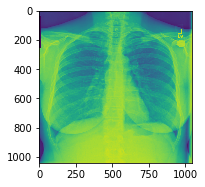

../data/siim-dataset/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10005.1517875220.958950/1.2.276.0.7230010.3.1.3.8323329.10005.1517875220.958949/1.2.276.0.7230010.3.1.4.8323329.10005.1517875220.958951.dcm
0.14300000000000002
[871.61904762 871.61904762] 0.8511904761904763
(872, 872)


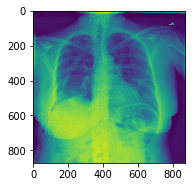

../data/siim-dataset/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10011.1517875220.977486/1.2.276.0.7230010.3.1.3.8323329.10011.1517875220.977485/1.2.276.0.7230010.3.1.4.8323329.10011.1517875220.977487.dcm
0.19431099999999998
[1184.37180952 1184.37180952] 1.156613095238095
(1184, 1184)


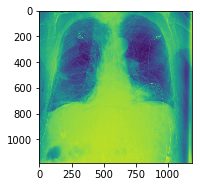

../data/siim-dataset/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10046.1517875221.743998/1.2.276.0.7230010.3.1.3.8323329.10046.1517875221.743997/1.2.276.0.7230010.3.1.4.8323329.10046.1517875221.743999.dcm
0.19430799999999998
[1184.35352381 1184.35352381] 1.156595238095238
(1184, 1184)


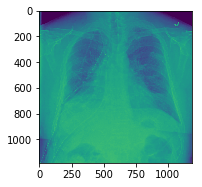

../data/siim-dataset/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10330.1517875223.181463/1.2.276.0.7230010.3.1.3.8323329.10330.1517875223.181462/1.2.276.0.7230010.3.1.4.8323329.10330.1517875223.181464.dcm
0.19431400000000001
[1184.39009524 1184.39009524] 1.1566309523809524
(1184, 1184)


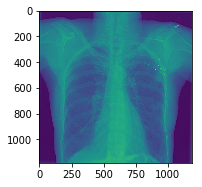

../data/siim-dataset/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.12873.1517875242.291014/1.2.276.0.7230010.3.1.3.8323329.12873.1517875242.291013/1.2.276.0.7230010.3.1.4.8323329.12873.1517875242.291015.dcm
0.19433599999999998
[1184.52419048 1184.52419048] 1.1567619047619047
(1185, 1185)


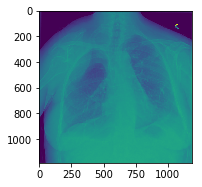

../data/siim-dataset/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.13617.1517875246.883247/1.2.276.0.7230010.3.1.3.8323329.13617.1517875246.883246/1.2.276.0.7230010.3.1.4.8323329.13617.1517875246.883248.dcm
0.193754
[1180.9767619 1180.9767619] 1.153297619047619
(1181, 1181)


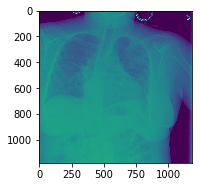

../data/siim-dataset/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.31878.1517875157.283409/1.2.276.0.7230010.3.1.3.8323329.31878.1517875157.283408/1.2.276.0.7230010.3.1.4.8323329.31878.1517875157.283410.dcm
0.115
[700.95238095 700.95238095] 0.6845238095238095
(701, 701)


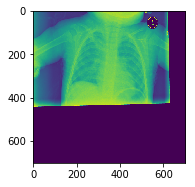

../data/siim-dataset/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.5257.1517875187.199473/1.2.276.0.7230010.3.1.3.8323329.5257.1517875187.199472/1.2.276.0.7230010.3.1.4.8323329.5257.1517875187.199474.dcm
0.19378399999999998
[1181.15961905 1181.15961905] 1.1534761904761903
(1181, 1181)


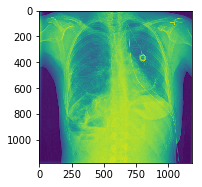

In [196]:
for val in df.PixelSpacing.unique():
    sample = df[df.PixelSpacing == val].iloc[0]
    fp = sample["fp"].replace("raw", "siim-dataset")
    print(fp)
    img = read_dcm(fp)
#     plt.subplot(121)
#     plt.imshow(img)
    plt.subplot(122)
    print(val)
    img, _ = resample(img, img, old_spacing = float(val), new_spacing=0.168)
    print(img.shape)
    plt.imshow(img), plt.show()

In [205]:
def cutBorders(X, y):
    shape = X.shape
    mask = X != 0
    coords = np.argwhere(mask)
    x0, y0 = coords.min(axis=0)
    x1, y1 = coords.max(axis=0) + 1
    X = X[x0:x1, y0:y1]
    y = y[x0:x1, y0:y1]
    X = cv2.resize(X, shape, interpolation=cv2.INTER_NEAREST)
    y = cv2.resize(y, shape, interpolation=cv2.INTER_NEAREST)
    return X, y

[ 0  1  3 10]


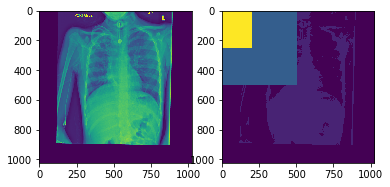

[ 0  1  3 10]
uint8 uint8


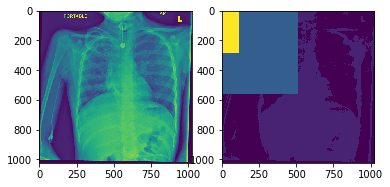

In [208]:
fp = "../data/siim-dataset/dicom-images-train/1.2.276.0.7230010.3.1.2.8323329.10000.1517875220.938529/1.2.276.0.7230010.3.1.3.8323329.10000.1517875220.938528/1.2.276.0.7230010.3.1.4.8323329.10000.1517875220.938530.dcm"
img = read_dcm(fp)
mask = (img > 125).astype(np.uint8)
mask[:500, :500] = 3
mask[:256, :200] = 10
print(np.unique(mask))
plt.subplot(121), plt.imshow(img)
plt.subplot(122), plt.imshow(mask)
plt.show()
img, mask = cutBorders(img, mask)
plt.subplot(121), plt.imshow(img)
plt.subplot(122), plt.imshow(mask)
print(np.unique(mask))
print(mask.dtype, img.dtype)
plt.show()

In [214]:
((df.mask_sum > 0) & (df.mask_sum < 5000)).sum()

740

In [218]:
WIDTH, HEIGHT = 1024, 1024
in_path = "../data/siim-dataset/train-rle.csv"
df = pd.read_csv(in_path, dtype=str, sep=", ")
it = df["EncodedPixels"].values
it = tqdm(it)
mask_sum_list = []
for rle_mask in it:
    if rle_mask == "-1":
        continue
    mask_sum_list.append((rle2mask(rle_mask, WIDTH, HEIGHT) > 125).sum())


/home/inkognita/.virtualenvs/ml-py3/lib/python3.5/site-packages/ipykernel_launcher.py:3: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  This is separate from the ipykernel package so we can avoid doing imports until


In [219]:
mask_sum_list = np.array(mask_sum_list)

In [221]:
(mask_sum_list < 3500).sum()

929